<a href="https://colab.research.google.com/github/WagnerLopesCardozo/Analise_de_Algoritmos_e_Estrutura_de_Dados/blob/main/Wagner_LopesCardozo_TrabalhoFinal.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

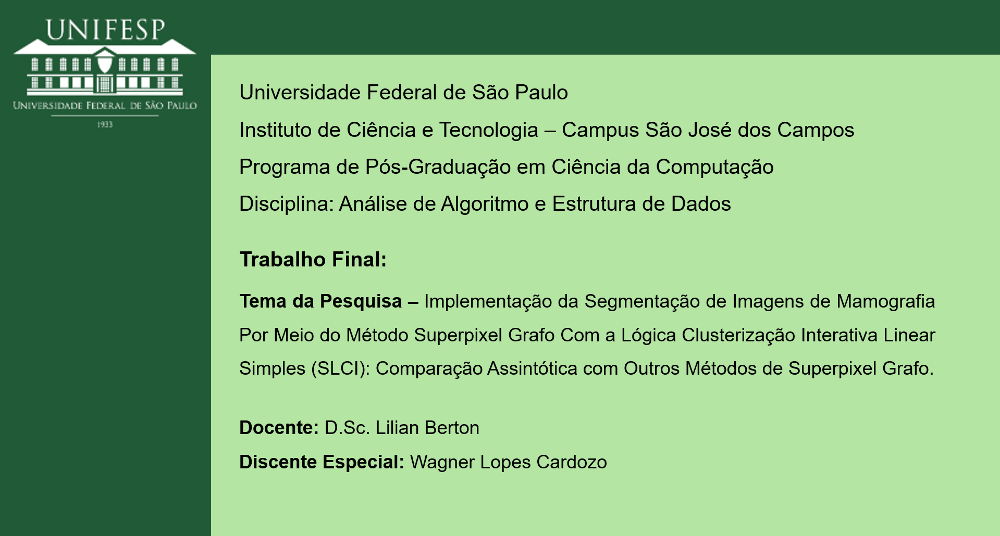

#<font color=lightgreen>Implementação do algoritmo SLCI para segmentação em imagem de exame de mamogafia, usando o método Superpixel fundamentado na TAD grafo.

Faça upload da imagem:


Saving 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia.png to 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia.png
Arquivo 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia.png carregado com sucesso!
Gerando superpixels...
Construindo o grafo...
Visualizando superpixels...


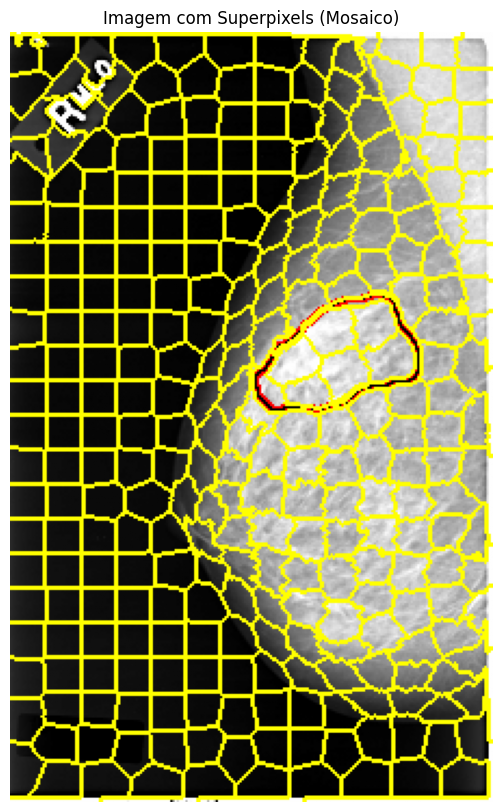

O grafo possui 290 nós e 780 arestas.


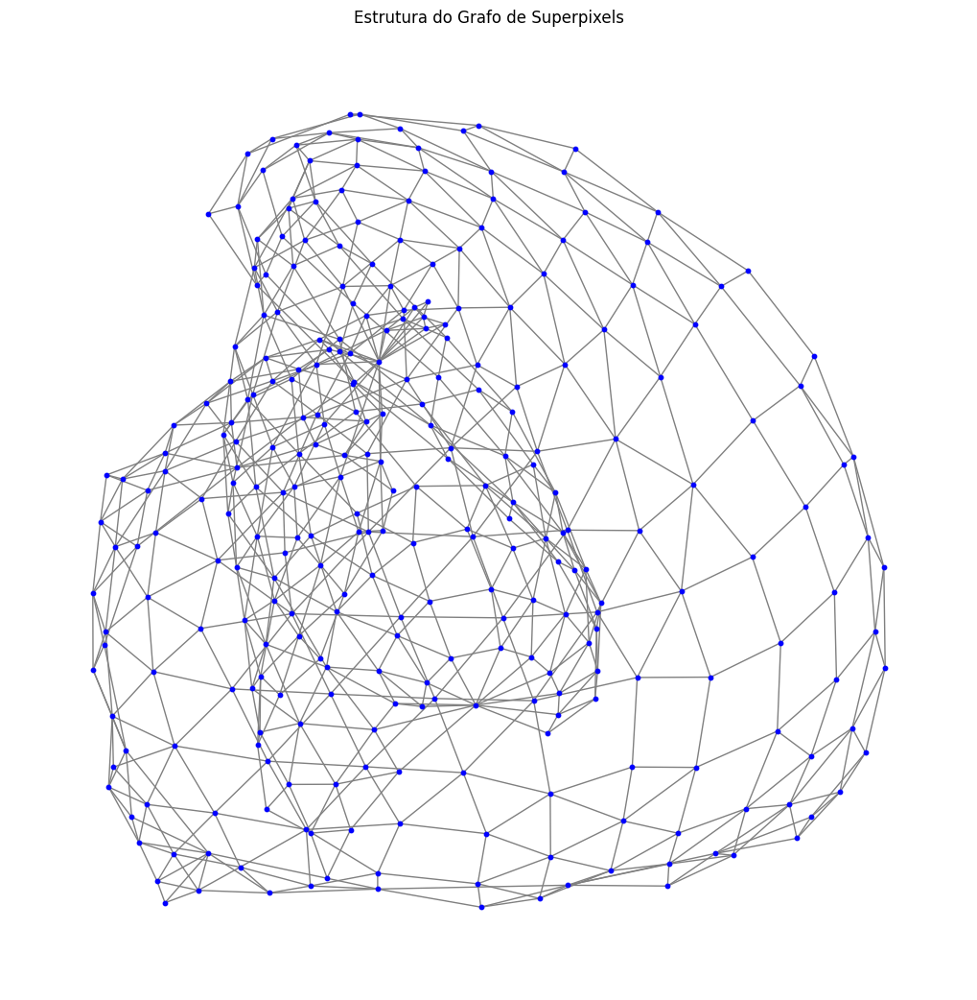

In [ ]:
# Importação das bibliotecas necessárias
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
from skimage import io, color
from skimage.segmentation import slic, mark_boundaries
import networkx as nx

def upload_image():
    """Solicita ao usuário o upload de uma imagem"""
    uploaded = files.upload()
    for filename in uploaded.keys():
        print(f"Arquivo {filename} carregado com sucesso!")
        return io.imread(filename)

def generate_superpixels(image, n_segments=200, compactness=10):
    """
    Gera superpixels usando a técnica SLIC.

    Parâmetros:
    - image: Imagem de entrada.
    - n_segments: Número de segmentos/superpixels desejados.
    - compactness: Parâmetro de compacidade do SLIC.

    Retorna:
    - segments: Superpixels gerados.
    """
    segments = slic(image, n_segments=n_segments, compactness=compactness, start_label=1)
    return segments

def build_graph_from_superpixels(image, segments):
    """
    Constrói um grafo com base nos superpixels.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Superpixels gerados.

    Retorna:
    - G: Grafo construído.
    """
    G = nx.Graph()

    # Identifica as dimensões da imagem
    rows, cols = segments.shape

    # Adiciona nós ao grafo, um para cada superpixel
    for seg_val in np.unique(segments):
        mask = segments == seg_val
        color_mean = image[mask].mean(axis=0)
        G.add_node(seg_val, color=tuple(color_mean))

    # Adiciona arestas entre superpixels vizinhos
    for r in range(rows - 1):
        for c in range(cols - 1):
            current = segments[r, c]
            neighbors = [segments[r+1, c], segments[r, c+1]]
            for neighbor in neighbors:
                if current != neighbor:
                    G.add_edge(current, neighbor)

    return G

def visualize_superpixels(image, segments):
    """
    Visualiza os superpixels na imagem original.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Superpixels gerados.
    """
    plt.figure(figsize=(10, 10))
    plt.imshow(mark_boundaries(image, segments))
    plt.axis('off')
    plt.title("Imagem com Superpixels (Mosaico)")
    plt.show()

# Pipeline Principal
def main():
    print("Faça upload da imagem:")
    image = upload_image()

    # Garantir que a imagem seja RGB
    if len(image.shape) == 2 or image.shape[2] == 1:
        image = color.gray2rgb(image)

    # Geração de Superpixels
    print("Gerando superpixels...")
    segments = generate_superpixels(image, n_segments=300, compactness=20)

    # Construção do Grafo
    print("Construindo o grafo...")
    G = build_graph_from_superpixels(image, segments)

    # Visualização
    print("Visualizando superpixels...")
    visualize_superpixels(image, segments)

    # Exibindo informações do grafo
    print(f"O grafo possui {len(G.nodes)} nós e {len(G.edges)} arestas.")
    plt.figure(figsize=(10, 10))
    pos = nx.spring_layout(G)
    nx.draw(G, pos, with_labels=False, node_size=10, node_color="blue", edge_color="gray")
    plt.title("Estrutura do Grafo de Superpixels")
    plt.show()

if __name__ == '__main__':
    main()


#<font color=lightgreen>Neste algoritmo foi aumentado o número de superpixels, consequentemente o número de centroides (nós) e arestas tendo assim um grafo com maior número de nós e arestas.

##OBS: Para criar superpixels menores e gerar um grafo com mais nós e arestas, é necessário aumentar o número de segmentos (n_segments) e ajustar a compactness para otimizar a segmentação. Aqui está o código modificado:

#Alterações realizadas:

##Aumentado n_segments:

* Alterado de 300 para 2000, criando muito mais superpixels.

##Diminuído compactness:

* Alterado de 20 para 5, resultando em bordas mais detalhadas entre os superpixels.

##Ajuste na visualização:

* Garantido que as alterações na segmentação são refletidas de forma clara na exibição dos superpixels e no grafo.

#Resultados esperados:

* Superpixels menores que capturam mais detalhes da imagem.

* Grafo com maior número de nós e arestas, representando as relações entre os superpixels.

* Maior resolução na segmentação.

Teste o código e veja como ele se comporta. Ajuste os valores de n_segments e compactness conforme necessário para obter o nível de detalhe desejado.

Faça upload da imagem:


Saving 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia.png to 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia (6).png
Arquivo 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia (6).png carregado com sucesso!
Gerando superpixels com alta resolução...
Construindo o grafo...
Visualizando superpixels...


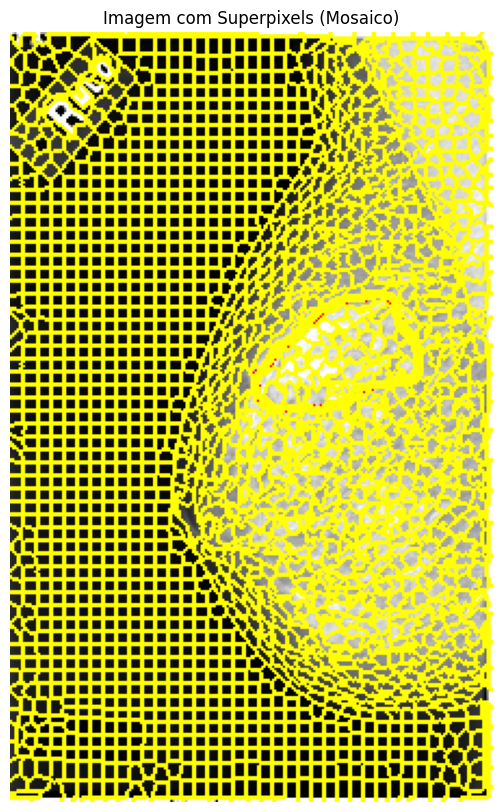

O grafo possui 2006 nós e 5077 arestas.


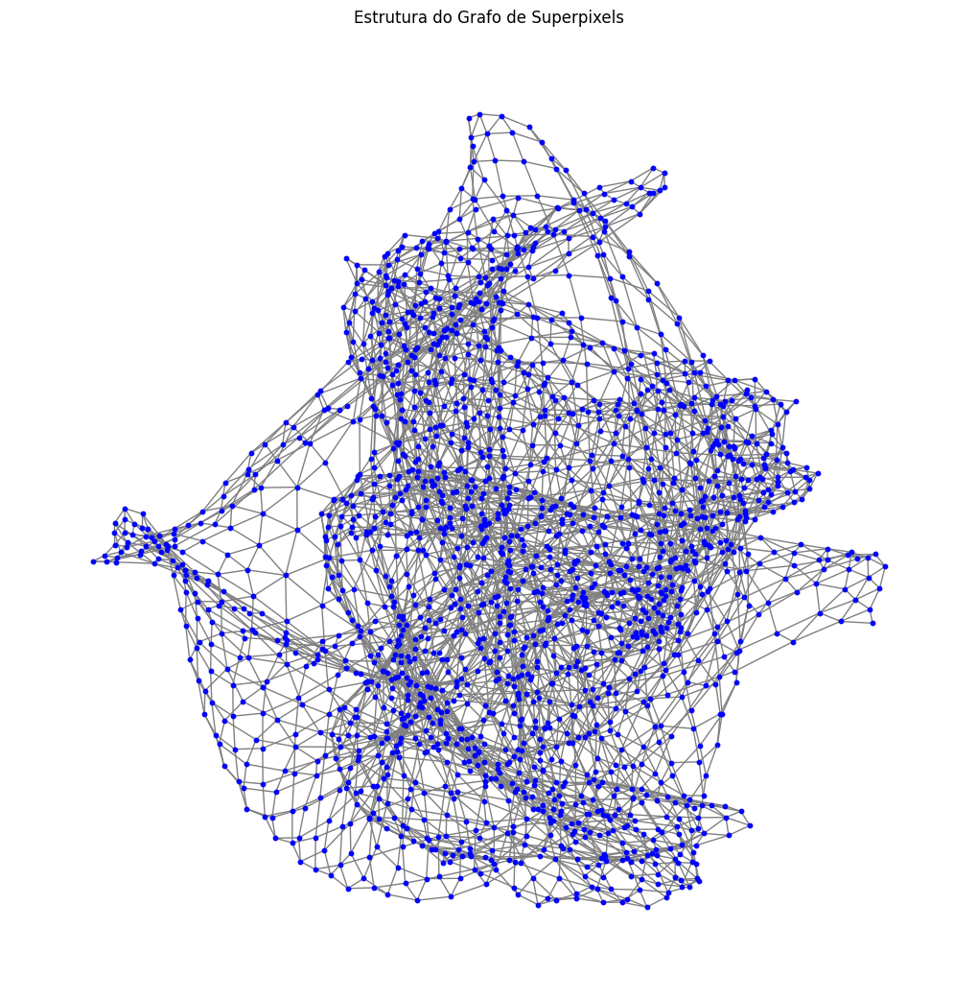

In [ ]:
# Importação das bibliotecas necessárias
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
from skimage import io, color
from skimage.segmentation import slic, mark_boundaries
import networkx as nx

def upload_image():
    """Solicita ao usuário o upload de uma imagem"""
    uploaded = files.upload()
    for filename in uploaded.keys():
        print(f"Arquivo {filename} carregado com sucesso!")
        return io.imread(filename)

def generate_superpixels(image, n_segments=2000, compactness=5):
    """
    Gera superpixels usando a técnica SLIC.

    Parâmetros:
    - image: Imagem de entrada.
    - n_segments: Número de segmentos/superpixels desejados.
    - compactness: Parâmetro de compacidade do SLIC.

    Retorna:
    - segments: Superpixels gerados.
    """
    segments = slic(image, n_segments=n_segments, compactness=compactness, start_label=1)
    return segments

def build_graph_from_superpixels(image, segments):
    """
    Constrói um grafo com base nos superpixels.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Superpixels gerados.

    Retorna:
    - G: Grafo construído.
    """
    G = nx.Graph()

    # Identifica as dimensões da imagem
    rows, cols = segments.shape

    # Adiciona nós ao grafo, um para cada superpixel
    for seg_val in np.unique(segments):
        mask = segments == seg_val
        color_mean = image[mask].mean(axis=0)
        G.add_node(seg_val, color=tuple(color_mean))

    # Adiciona arestas entre superpixels vizinhos
    for r in range(rows - 1):
        for c in range(cols - 1):
            current = segments[r, c]
            neighbors = [segments[r+1, c], segments[r, c+1]]
            for neighbor in neighbors:
                if current != neighbor:
                    G.add_edge(current, neighbor)

    return G

def visualize_superpixels(image, segments):
    """
    Visualiza os superpixels na imagem original.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Superpixels gerados.
    """
    plt.figure(figsize=(10, 10))
    plt.imshow(mark_boundaries(image, segments))
    plt.axis('off')
    plt.title("Imagem com Superpixels (Mosaico)")
    plt.show()

# Pipeline Principal
def main():
    print("Faça upload da imagem:")
    image = upload_image()

    # Garantir que a imagem seja RGB
    if len(image.shape) == 2 or image.shape[2] == 1:
        image = color.gray2rgb(image)

    # Geração de Superpixels com mais segmentos e menor compactness
    print("Gerando superpixels com alta resolução...")
    segments = generate_superpixels(image, n_segments=2000, compactness=5)

    # Construção do Grafo
    print("Construindo o grafo...")
    G = build_graph_from_superpixels(image, segments)

    # Visualização
    print("Visualizando superpixels...")
    visualize_superpixels(image, segments)

    # Exibindo informações do grafo
    print(f"O grafo possui {len(G.nodes)} nós e {len(G.edges)} arestas.")
    plt.figure(figsize=(10, 10))
    pos = nx.spring_layout(G)
    nx.draw(G, pos, with_labels=False, node_size=10, node_color="blue", edge_color="gray")
    plt.title("Estrutura do Grafo de Superpixels")
    plt.show()

if __name__ == '__main__':
    main()


#<font color=lightgreen>Atualizando a biblioteca Scikit-Image no ambiente de desenvolvimento integrado IDE do Google Colab.

In [ ]:
!pip install -U scikit-image


#<font color=lightgreen>Instanciando uma versão manualmente da biblioteca Scikit-Image objetivando melhor desempenho da aplicação do método segundo documentação da biblioteca.

In [ ]:
!pip install scikit-image==0.19.3


#<font color=lightgreen>Evoluindo com o estudo implementando o algoritmo que segmenta a imagem com SLIC e exibe ao lado a RAG região adjacente do grafo com os centroides e arestas sendo o conceito de grafo para as segmentações.

Faça upload da imagem:


Saving 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia.png to 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia (3).png
Arquivo 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia (3).png carregado com sucesso!
Gerando superpixels...
Construindo a RAG manualmente...
Visualizando a RAG...


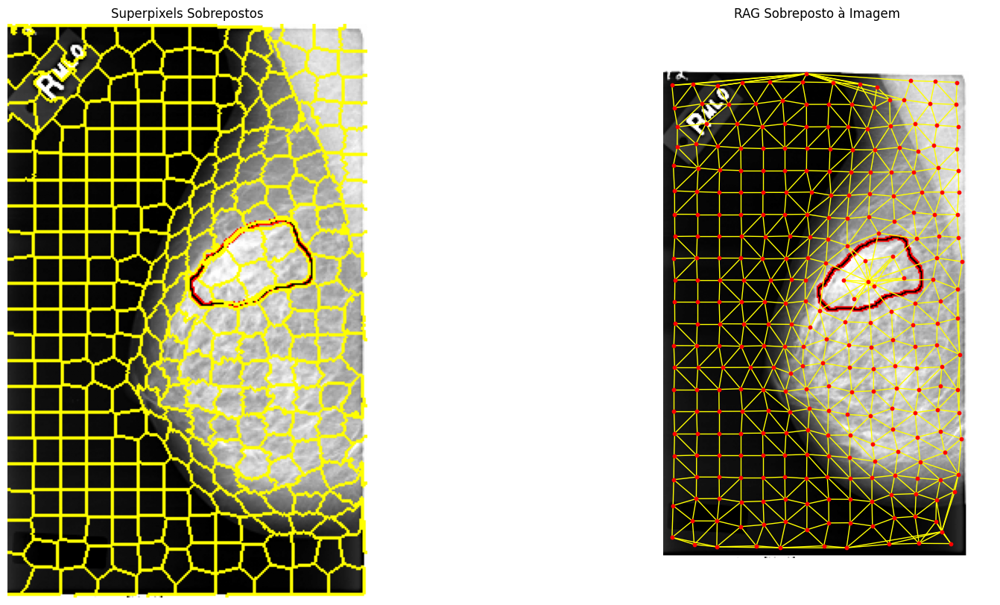

In [ ]:
# Importação das bibliotecas necessárias
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
from skimage import io, color
from skimage.segmentation import slic, mark_boundaries
from skimage.future.graph import rag_mean_color  # Removido
from skimage.color import label2rgb
import networkx as nx

def upload_image():
    """Solicita ao usuário o upload de uma imagem"""
    uploaded = files.upload()
    for filename in uploaded.keys():
        print(f"Arquivo {filename} carregado com sucesso!")
        return io.imread(filename)

def generate_superpixels(image, n_segments=200, compactness=10):
    """
    Gera superpixels usando a técnica SLIC.

    Parâmetros:
    - image: Imagem de entrada.
    - n_segments: Número de segmentos/superpixels desejados.
    - compactness: Parâmetro de compacidade do SLIC.

    Retorna:
    - segments: Superpixels gerados.
    """
    segments = slic(image, n_segments=n_segments, compactness=compactness, start_label=1)
    return segments

def build_rag_manual(image, segments):
    """
    Constrói o Region Adjacency Graph (RAG) manualmente.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Superpixels gerados.

    Retorna:
    - G: Grafo construído.
    """
    G = nx.Graph()

    # Adiciona os nós ao grafo
    for region in np.unique(segments):
        G.add_node(region)

    # Identifica pixels vizinhos para adicionar arestas
    rows, cols = segments.shape
    for r in range(rows - 1):
        for c in range(cols - 1):
            current = segments[r, c]
            right = segments[r, c + 1]
            down = segments[r + 1, c]
            if current != right:
                G.add_edge(current, right)
            if current != down:
                G.add_edge(current, down)
    return G

def visualize_rag(image, segments, rag):
    """
    Visualiza a RAG sobreposta à imagem fornecida.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Superpixels gerados.
    - rag: Grafo de Adjacência da Região (RAG).
    """
    fig, ax = plt.subplots(1, 2, figsize=(20, 10))

    # Exibir os superpixels sobre a imagem original
    ax[0].imshow(mark_boundaries(image, segments))
    ax[0].set_title("Superpixels Sobrepostos")
    ax[0].axis("off")

    # Exibir o grafo sobreposto
    ax[1].imshow(image)
    pos = {}
    for region in np.unique(segments):
        mask = segments == region
        y, x = np.mean(np.argwhere(mask), axis=0)
        pos[region] = (x, y)

    nx.draw(rag, pos, ax=ax[1], node_size=10, edge_color="yellow", node_color="red", with_labels=False)
    ax[1].set_title("RAG Sobreposto à Imagem")
    plt.show()

# Pipeline Principal
def main():
    print("Faça upload da imagem:")
    image = upload_image()

    # Garantir que a imagem seja RGB
    if len(image.shape) == 2 or image.shape[2] == 1:
        image = color.gray2rgb(image)

    # Geração de Superpixels
    print("Gerando superpixels...")
    segments = generate_superpixels(image, n_segments=300, compactness=20)

    # Construção do RAG manualmente
    print("Construindo a RAG manualmente...")
    rag = build_rag_manual(image, segments)

    # Visualização
    print("Visualizando a RAG...")
    visualize_rag(image, segments, rag)

if __name__ == '__main__':
    main()


#<font color=lightgreen>Implementando o algoritmo que segmenta a imagem com SLIC, exibe a RAGs regiões adjacentes do grafo separada e exibe as segmentações com as RAGs.

Faça upload da imagem:


Saving 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia.png to 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia (4).png
Arquivo 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia (4).png carregado com sucesso!
Gerando superpixels...
Construindo a RAG manualmente...
Visualizando a RAG e os Superpixels...


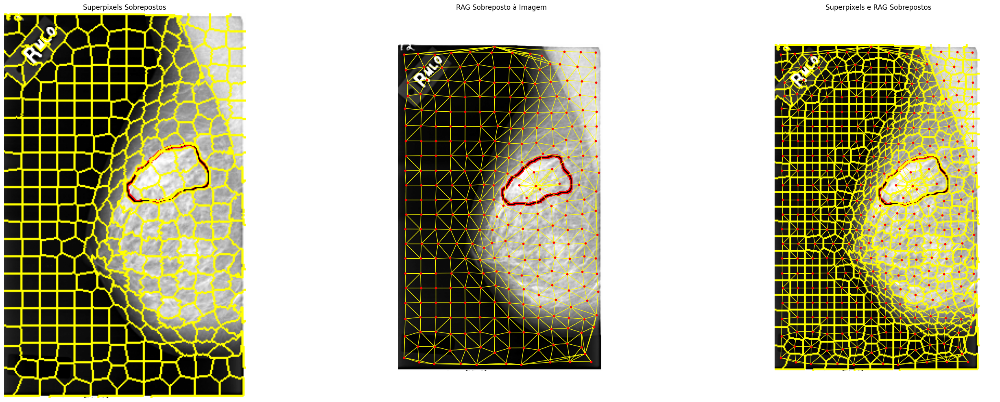

In [ ]:
# Importação das bibliotecas necessárias
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
from skimage import io, color
from skimage.segmentation import slic, mark_boundaries
import networkx as nx

def upload_image():
    """Solicita ao usuário o upload de uma imagem."""
    uploaded = files.upload()
    for filename in uploaded.keys():
        print(f"Arquivo {filename} carregado com sucesso!")
        return io.imread(filename)

def generate_superpixels(image, n_segments=200, compactness=10):
    """
    Gera superpixels usando a técnica SLIC.

    Parâmetros:
    - image: Imagem de entrada.
    - n_segments: Número de segmentos/superpixels desejados.
    - compactness: Parâmetro de compacidade do SLIC.

    Retorna:
    - segments: Superpixels gerados.
    """
    segments = slic(image, n_segments=n_segments, compactness=compactness, start_label=1)
    return segments

def build_rag_manual(image, segments):
    """
    Constrói o Region Adjacency Graph (RAG) manualmente.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Superpixels gerados.

    Retorna:
    - G: Grafo construído.
    """
    G = nx.Graph()

    # Adiciona os nós ao grafo
    for region in np.unique(segments):
        G.add_node(region)

    # Identifica pixels vizinhos para adicionar arestas
    rows, cols = segments.shape
    for r in range(rows - 1):
        for c in range(cols - 1):
            current = segments[r, c]
            right = segments[r, c + 1]
            down = segments[r + 1, c]
            if current != right:
                G.add_edge(current, right)
            if current != down:
                G.add_edge(current, down)
    return G

def visualize_all(image, segments, rag):
    """
    Exibe três imagens lado a lado:
    1. Superpixels sobrepostos à imagem original.
    2. RAG sobreposto à imagem original.
    3. Superpixels e RAG sobrepostos à imagem original.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Superpixels gerados.
    - rag: Grafo de Adjacência da Região (RAG).
    """
    fig, ax = plt.subplots(1, 3, figsize=(30, 10))

    # Superpixels sobrepostos
    ax[0].imshow(mark_boundaries(image, segments))
    ax[0].set_title("Superpixels Sobrepostos")
    ax[0].axis("off")

    # RAG sobreposto à imagem
    ax[1].imshow(image)
    pos = {}
    for region in np.unique(segments):
        mask = segments == region
        y, x = np.mean(np.argwhere(mask), axis=0)
        pos[region] = (x, y)

    nx.draw(rag, pos, ax=ax[1], node_size=10, edge_color="yellow", node_color="red", with_labels=False)
    ax[1].set_title("RAG Sobreposto à Imagem")
    ax[1].axis("off")

    # Superpixels e RAG juntos
    ax[2].imshow(mark_boundaries(image, segments))
    nx.draw(rag, pos, ax=ax[2], node_size=10, edge_color="yellow", node_color="red", with_labels=False)
    ax[2].set_title("Superpixels e RAG Sobrepostos")
    ax[2].axis("off")

    plt.tight_layout()
    plt.show()

# Pipeline Principal
def main():
    print("Faça upload da imagem:")
    image = upload_image()

    # Garantir que a imagem seja RGB
    if len(image.shape) == 2 or image.shape[2] == 1:
        image = color.gray2rgb(image)

    # Geração de Superpixels
    print("Gerando superpixels...")
    segments = generate_superpixels(image, n_segments=300, compactness=20)

    # Construção do RAG manualmente
    print("Construindo a RAG manualmente...")
    rag = build_rag_manual(image, segments)

    # Visualização
    print("Visualizando a RAG e os Superpixels...")
    visualize_all(image, segments, rag)

if __name__ == '__main__':
    main()


#<font color=lightgreen>Evoluindo com o estudo, exibindo a quantidade de centróides (nós) e quantidade de arestas. Exibindo também a figura da imagem com o mapa contendo a quantidade de centroides gerados (nós) realizando uma contagem regressiva comprovando na imagem a quantidade de centroides contabilizados.

Faça upload da imagem:


Saving 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia.png to 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia (6).png
Arquivo 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia (6).png carregado com sucesso!
Gerando superpixels...
Construindo a RAG manualmente...
Visualizando a RAG e os Superpixels...


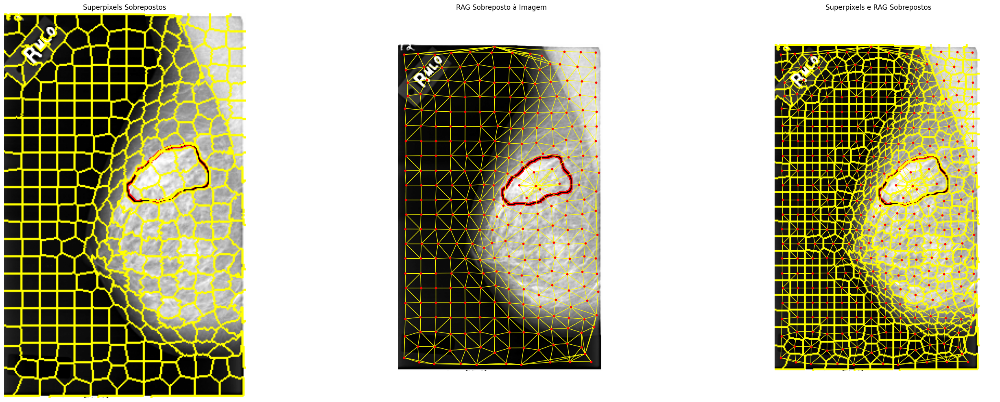

╒════════════════╤══════════════╕
│ Propriedade    │   Quantidade │
╞════════════════╪══════════════╡
│ Nós (Vértices) │          290 │
├────────────────┼──────────────┤
│ Arestas        │          780 │
╘════════════════╧══════════════╛


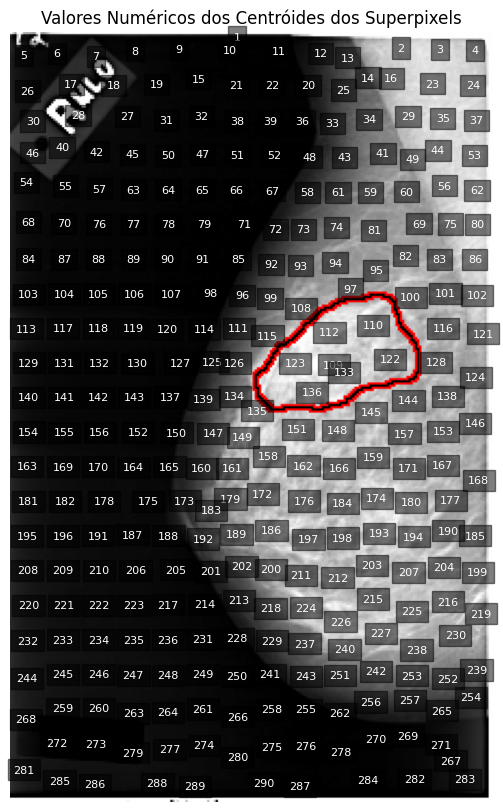

In [ ]:
# Importação das bibliotecas necessárias
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
from skimage import io, color
from skimage.segmentation import slic, mark_boundaries
import networkx as nx
from tabulate import tabulate

def upload_image():
    """Solicita ao usuário o upload de uma imagem."""
    uploaded = files.upload()
    for filename in uploaded.keys():
        print(f"Arquivo {filename} carregado com sucesso!")
        return io.imread(filename)

def generate_superpixels(image, n_segments=200, compactness=10):
    """
    Gera superpixels usando a técnica SLIC.

    Parâmetros:
    - image: Imagem de entrada.
    - n_segments: Número de segmentos/superpixels desejados.
    - compactness: Parâmetro de compacidade do SLIC.

    Retorna:
    - segments: Superpixels gerados.
    """
    segments = slic(image, n_segments=n_segments, compactness=compactness, start_label=1)
    return segments

def build_rag_manual(image, segments):
    """
    Constrói o Region Adjacency Graph (RAG) manualmente.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Superpixels gerados.

    Retorna:
    - G: Grafo construído.
    """
    G = nx.Graph()

    # Adiciona os nós ao grafo
    for region in np.unique(segments):
        G.add_node(region)

    # Identifica pixels vizinhos para adicionar arestas
    rows, cols = segments.shape
    for r in range(rows - 1):
        for c in range(cols - 1):
            current = segments[r, c]
            right = segments[r, c + 1]
            down = segments[r + 1, c]
            if current != right:
                G.add_edge(current, right)
            if current != down:
                G.add_edge(current, down)
    return G

def visualize_all(image, segments, rag):
    """
    Exibe três imagens lado a lado e gera o mapa dos valores numéricos dos centróides:
    1. Superpixels sobrepostos à imagem original.
    2. RAG sobreposto à imagem original.
    3. Superpixels e RAG sobrepostos à imagem original.

    Além disso:
    - Exibe a tabela com a quantidade de nós e arestas.
    - Exibe os valores numéricos dos centróides sobre a imagem.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Superpixels gerados.
    - rag: Grafo de Adjacência da Região (RAG).
    """
    # Exibição das três imagens
    fig, ax = plt.subplots(1, 3, figsize=(30, 10))

    # Superpixels sobrepostos
    ax[0].imshow(mark_boundaries(image, segments))
    ax[0].set_title("Superpixels Sobrepostos")
    ax[0].axis("off")

    # RAG sobreposto à imagem
    ax[1].imshow(image)
    pos = {}
    for region in np.unique(segments):
        mask = segments == region
        y, x = np.mean(np.argwhere(mask), axis=0)
        pos[region] = (x, y)

    nx.draw(rag, pos, ax=ax[1], node_size=10, edge_color="yellow", node_color="red", with_labels=False)
    ax[1].set_title("RAG Sobreposto à Imagem")
    ax[1].axis("off")

    # Superpixels e RAG juntos
    ax[2].imshow(mark_boundaries(image, segments))
    nx.draw(rag, pos, ax=ax[2], node_size=10, edge_color="yellow", node_color="red", with_labels=False)
    ax[2].set_title("Superpixels e RAG Sobrepostos")
    ax[2].axis("off")

    plt.tight_layout()
    plt.show()

    # Exibição da tabela com informações do RAG
    node_count = len(rag.nodes)
    edge_count = len(rag.edges)
    table = [["Nós (Vértices)", node_count], ["Arestas", edge_count]]
    print(tabulate(table, headers=["Propriedade", "Quantidade"], tablefmt="fancy_grid"))

    # Exibir os valores numéricos dos centróides na imagem
    plt.figure(figsize=(10, 10))
    plt.imshow(image)

    for region in np.unique(segments):
        mask = segments == region
        y, x = np.mean(np.argwhere(mask), axis=0)
        plt.text(x, y, str(region), color="white", fontsize=8, ha="center", va="center", bbox=dict(facecolor="black", alpha=0.5))

    plt.title("Valores Numéricos dos Centróides dos Superpixels")
    plt.axis("off")
    plt.show()

# Pipeline Principal
def main():
    print("Faça upload da imagem:")
    image = upload_image()

    # Garantir que a imagem seja RGB
    if len(image.shape) == 2 or image.shape[2] == 1:
        image = color.gray2rgb(image)

    # Geração de Superpixels
    print("Gerando superpixels...")
    segments = generate_superpixels(image, n_segments=300, compactness=20)

    # Construção do RAG manualmente
    print("Construindo a RAG manualmente...")
    rag = build_rag_manual(image, segments)

    # Visualização
    print("Visualizando a RAG e os Superpixels...")
    visualize_all(image, segments, rag)

if __name__ == '__main__':
    main()


#<font color=lightgreen>Gerando o mapa na imagem segmentada com os valores numéricos do pixel central de cada segmento (superpixel).

Faça upload da imagem:


Saving 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia.png to 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia (7).png
Arquivo 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia (7).png carregado com sucesso!
Gerando superpixels...
Construindo a RAG manualmente...
Calculando intensidades médias dos superpixels...
Visualizando a RAG e os Superpixels...


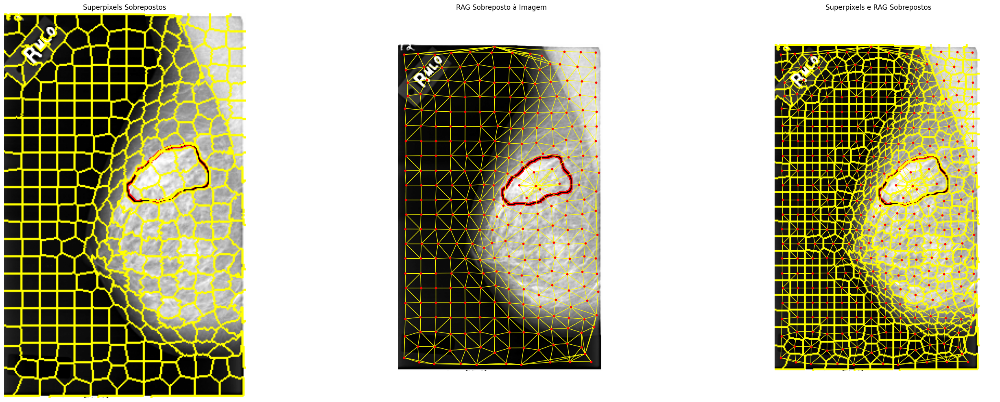

╒════════════════╤══════════════╕
│ Propriedade    │   Quantidade │
╞════════════════╪══════════════╡
│ Nós (Vértices) │          290 │
├────────────────┼──────────────┤
│ Arestas        │          780 │
╘════════════════╧══════════════╛


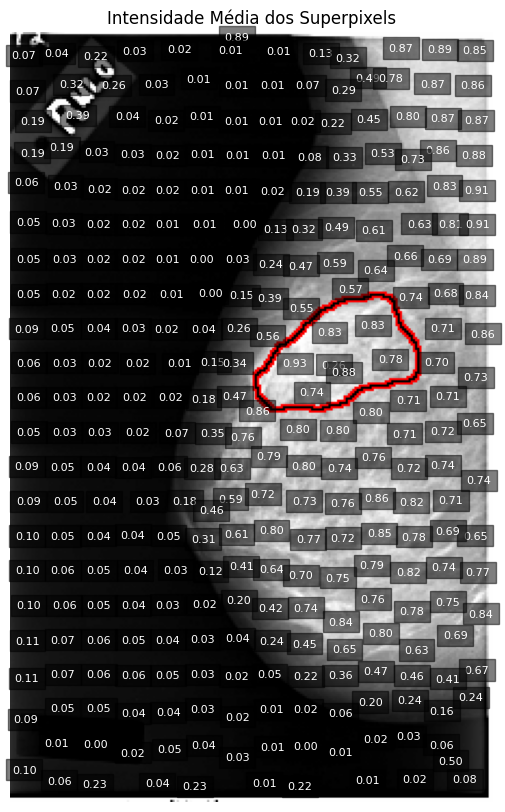

In [ ]:
# Importação das bibliotecas necessárias
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
from skimage import io, color
from skimage.segmentation import slic, mark_boundaries
import networkx as nx
from tabulate import tabulate

def upload_image():
    """Solicita ao usuário o upload de uma imagem."""
    uploaded = files.upload()
    for filename in uploaded.keys():
        print(f"Arquivo {filename} carregado com sucesso!")
        return io.imread(filename)

def generate_superpixels(image, n_segments=200, compactness=10):
    """
    Gera superpixels usando a técnica SLIC.

    Parâmetros:
    - image: Imagem de entrada.
    - n_segments: Número de segmentos/superpixels desejados.
    - compactness: Parâmetro de compacidade do SLIC.

    Retorna:
    - segments: Superpixels gerados.
    """
    segments = slic(image, n_segments=n_segments, compactness=compactness, start_label=1)
    return segments

def build_rag_manual(image, segments):
    """
    Constrói o Region Adjacency Graph (RAG) manualmente.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Superpixels gerados.

    Retorna:
    - G: Grafo construído.
    """
    G = nx.Graph()

    # Adiciona os nós ao grafo
    for region in np.unique(segments):
        G.add_node(region)

    # Identifica pixels vizinhos para adicionar arestas
    rows, cols = segments.shape
    for r in range(rows - 1):
        for c in range(cols - 1):
            current = segments[r, c]
            right = segments[r, c + 1]
            down = segments[r + 1, c]
            if current != right:
                G.add_edge(current, right)
            if current != down:
                G.add_edge(current, down)
    return G

def calculate_superpixel_intensities(image, segments):
    """
    Calcula a intensidade média dos pixels em cada superpixel.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Superpixels gerados.

    Retorna:
    - intensities: Dicionário com o valor médio de intensidade para cada superpixel.
    """
    intensities = {}
    for region in np.unique(segments):
        mask = segments == region
        # Calcula a média das intensidades (converte para escala de cinza se for RGB)
        if len(image.shape) == 3:  # Imagem RGB
            gray_image = color.rgb2gray(image)
        else:
            gray_image = image
        intensities[region] = np.mean(gray_image[mask])
    return intensities

def visualize_all(image, segments, rag, intensities):
    """
    Exibe três imagens lado a lado e gera o mapa dos valores numéricos das intensidades dos centróides:
    1. Superpixels sobrepostos à imagem original.
    2. RAG sobreposto à imagem original.
    3. Superpixels e RAG sobrepostos à imagem original.

    Além disso:
    - Exibe a tabela com a quantidade de nós e arestas.
    - Exibe os valores numéricos das intensidades dos centróides sobre a imagem.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Superpixels gerados.
    - rag: Grafo de Adjacência da Região (RAG).
    - intensities: Dicionário com as intensidades médias dos superpixels.
    """
    # Exibição das três imagens
    fig, ax = plt.subplots(1, 3, figsize=(30, 10))

    # Superpixels sobrepostos
    ax[0].imshow(mark_boundaries(image, segments))
    ax[0].set_title("Superpixels Sobrepostos")
    ax[0].axis("off")

    # RAG sobreposto à imagem
    ax[1].imshow(image)
    pos = {}
    for region in np.unique(segments):
        mask = segments == region
        y, x = np.mean(np.argwhere(mask), axis=0)
        pos[region] = (x, y)

    nx.draw(rag, pos, ax=ax[1], node_size=10, edge_color="yellow", node_color="red", with_labels=False)
    ax[1].set_title("RAG Sobreposto à Imagem")
    ax[1].axis("off")

    # Superpixels e RAG juntos
    ax[2].imshow(mark_boundaries(image, segments))
    nx.draw(rag, pos, ax=ax[2], node_size=10, edge_color="yellow", node_color="red", with_labels=False)
    ax[2].set_title("Superpixels e RAG Sobrepostos")
    ax[2].axis("off")

    plt.tight_layout()
    plt.show()

    # Exibição da tabela com informações do RAG
    node_count = len(rag.nodes)
    edge_count = len(rag.edges)
    table = [["Nós (Vértices)", node_count], ["Arestas", edge_count]]
    print(tabulate(table, headers=["Propriedade", "Quantidade"], tablefmt="fancy_grid"))

    # Exibir os valores das intensidades dos centróides na imagem
    plt.figure(figsize=(10, 10))
    plt.imshow(image)

    for region in np.unique(segments):
        mask = segments == region
        y, x = np.mean(np.argwhere(mask), axis=0)
        intensity = intensities[region]
        plt.text(x, y, f"{intensity:.2f}", color="white", fontsize=8, ha="center", va="center", bbox=dict(facecolor="black", alpha=0.5))

    plt.title("Intensidade Média dos Superpixels")
    plt.axis("off")
    plt.show()

# Pipeline Principal
def main():
    print("Faça upload da imagem:")
    image = upload_image()

    # Garantir que a imagem seja RGB
    if len(image.shape) == 2 or image.shape[2] == 1:
        image = color.gray2rgb(image)

    # Geração de Superpixels
    print("Gerando superpixels...")
    segments = generate_superpixels(image, n_segments=300, compactness=20)

    # Construção do RAG manualmente
    print("Construindo a RAG manualmente...")
    rag = build_rag_manual(image, segments)

    # Cálculo das intensidades médias dos superpixels
    print("Calculando intensidades médias dos superpixels...")
    intensities = calculate_superpixel_intensities(image, segments)

    # Visualização
    print("Visualizando a RAG e os Superpixels...")
    visualize_all(image, segments, rag, intensities)

if __name__ == '__main__':
    main()


#<font color=lightgreen>Gerando a máscara de segmentação.

##Instrução:

##Será solicitado ao usuário os valores dos centroides para que o agoritmo gere a máscara de segmentação somente usando os valores dos centroides escolhidos pelo usuário.

Faça upload da imagem:


Saving 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia.png to 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia (8).png
Arquivo 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia (8).png carregado com sucesso!
Gerando superpixels...
Construindo a RAG manualmente...
Visualizando a RAG e os Superpixels...


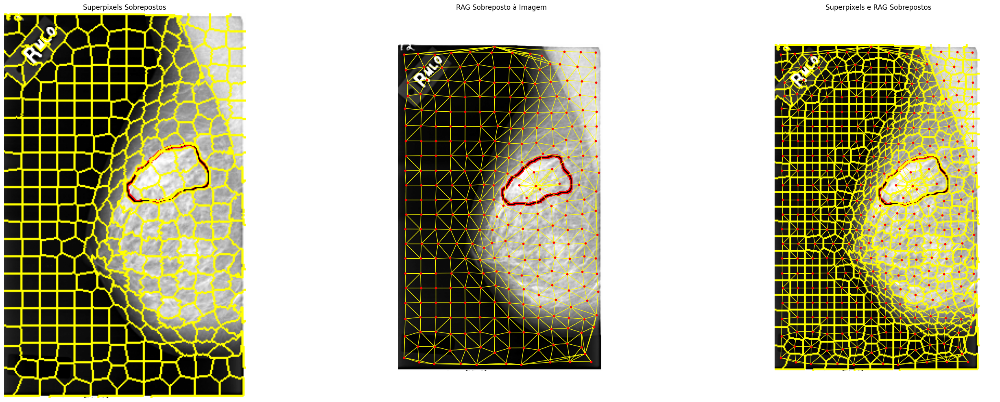

╒════════════════╤══════════════╕
│ Propriedade    │   Quantidade │
╞════════════════╪══════════════╡
│ Nós (Vértices) │          290 │
├────────────────┼──────────────┤
│ Arestas        │          780 │
╘════════════════╧══════════════╛


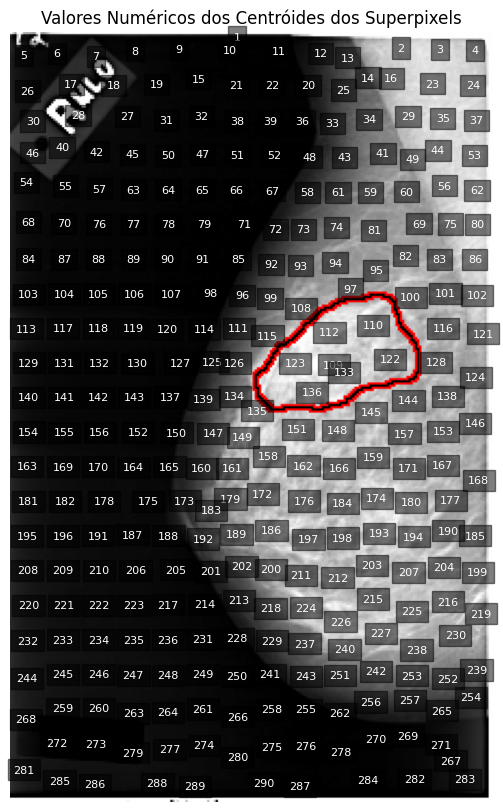

Digite os números dos centróides selecionados, separados por vírgula: 109, 110, 112, 122, 123, 133, 136


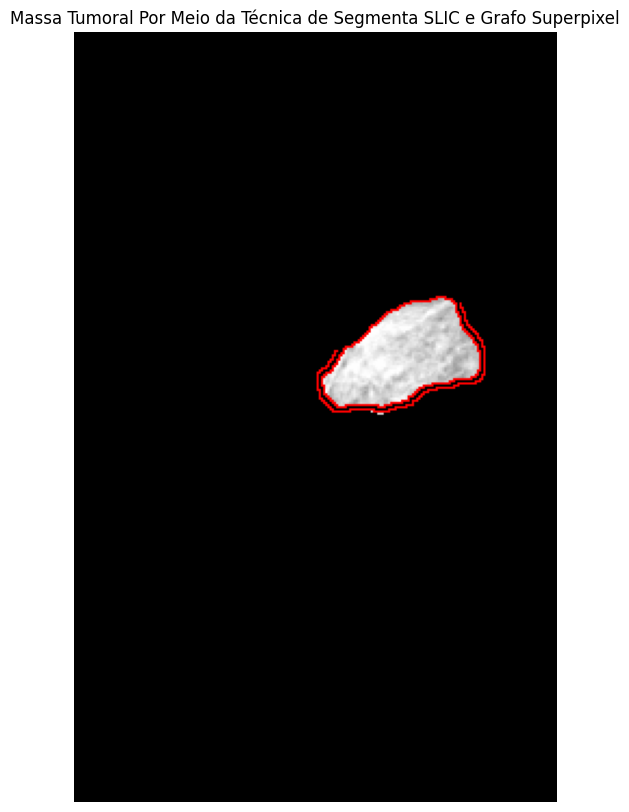

In [ ]:
# Importação das bibliotecas necessárias
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
from skimage import io, color
from skimage.segmentation import slic, mark_boundaries
import networkx as nx
from tabulate import tabulate

def upload_image():
    """Solicita ao usuário o upload de uma imagem."""
    uploaded = files.upload()
    for filename in uploaded.keys():
        print(f"Arquivo {filename} carregado com sucesso!")
        return io.imread(filename)

def generate_superpixels(image, n_segments=200, compactness=10):
    """
    Gera superpixels usando a técnica SLIC.

    Parâmetros:
    - image: Imagem de entrada.
    - n_segments: Número de segmentos/superpixels desejados.
    - compactness: Parâmetro de compacidade do SLIC.

    Retorna:
    - segments: Superpixels gerados.
    """
    segments = slic(image, n_segments=n_segments, compactness=compactness, start_label=1)
    return segments

def build_rag_manual(image, segments):
    """
    Constrói o Region Adjacency Graph (RAG) manualmente.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Superpixels gerados.

    Retorna:
    - G: Grafo construído.
    """
    G = nx.Graph()

    # Adiciona os nós ao grafo
    for region in np.unique(segments):
        G.add_node(region)

    # Identifica pixels vizinhos para adicionar arestas
    rows, cols = segments.shape
    for r in range(rows - 1):
        for c in range(cols - 1):
            current = segments[r, c]
            right = segments[r, c + 1]
            down = segments[r + 1, c]
            if current != right:
                G.add_edge(current, right)
            if current != down:
                G.add_edge(current, down)
    return G

def visualize_all(image, segments, rag):
    """
    Exibe três imagens lado a lado e gera o mapa dos valores numéricos dos centróides:
    - Superpixels sobrepostos.
    - RAG sobreposto à imagem.
    - Superpixels e RAG juntos.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Superpixels gerados.
    - rag: Grafo de Adjacência da Região (RAG).
    """
    # Exibição das três imagens
    fig, ax = plt.subplots(1, 3, figsize=(30, 10))

    # Superpixels sobrepostos
    ax[0].imshow(mark_boundaries(image, segments))
    ax[0].set_title("Superpixels Sobrepostos")
    ax[0].axis("off")

    # RAG sobreposto
    ax[1].imshow(image)
    pos = {}
    for region in np.unique(segments):
        mask = segments == region
        y, x = np.mean(np.argwhere(mask), axis=0)
        pos[region] = (x, y)

    nx.draw(rag, pos, ax=ax[1], node_size=10, edge_color="yellow", node_color="red", with_labels=False)
    ax[1].set_title("RAG Sobreposto à Imagem")
    ax[1].axis("off")

    # Superpixels e RAG juntos
    ax[2].imshow(mark_boundaries(image, segments))
    nx.draw(rag, pos, ax=ax[2], node_size=10, edge_color="yellow", node_color="red", with_labels=False)
    ax[2].set_title("Superpixels e RAG Sobrepostos")
    ax[2].axis("off")

    plt.tight_layout()
    plt.show()

    # Exibição da tabela com informações do RAG
    node_count = len(rag.nodes)
    edge_count = len(rag.edges)
    table = [["Nós (Vértices)", node_count], ["Arestas", edge_count]]
    print(tabulate(table, headers=["Propriedade", "Quantidade"], tablefmt="fancy_grid"))

    # Exibir os valores numéricos dos centróides na imagem
    plt.figure(figsize=(10, 10))
    plt.imshow(image)

    for region in np.unique(segments):
        mask = segments == region
        y, x = np.mean(np.argwhere(mask), axis=0)
        plt.text(x, y, str(region), color="white", fontsize=8, ha="center", va="center", bbox=dict(facecolor="black", alpha=0.5))

    plt.title("Valores Numéricos dos Centróides dos Superpixels")
    plt.axis("off")
    plt.show()

def select_and_visualize_superpixels(image, segments):
    """
    Permite ao usuário selecionar os valores dos centróides e exibir os superpixels correspondentes.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Superpixels gerados.
    """
    selected_regions = input("Digite os números dos centróides selecionados, separados por vírgula: ")
    selected_regions = [int(region.strip()) for region in selected_regions.split(",")]

    # Criar uma máscara para os superpixels selecionados
    mask = np.isin(segments, selected_regions)
    selected_image = np.zeros_like(image)
    selected_image[mask] = image[mask]

    # Exibir a imagem com os superpixels selecionados
    plt.figure(figsize=(10, 10))
    plt.imshow(selected_image)
    plt.title("Massa Tumoral Por Meio da Técnica de Segmenta SLIC e Grafo Superpixel")
    plt.axis("off")
    plt.show()

# Pipeline Principal
def main():
    print("Faça upload da imagem:")
    image = upload_image()

    # Garantir que a imagem seja RGB
    if len(image.shape) == 2 or image.shape[2] == 1:
        image = color.gray2rgb(image)

    # Geração de Superpixels
    print("Gerando superpixels...")
    segments = generate_superpixels(image, n_segments=300, compactness=20)

    # Construção do RAG manualmente
    print("Construindo a RAG manualmente...")
    rag = build_rag_manual(image, segments)

    # Visualização
    print("Visualizando a RAG e os Superpixels...")
    visualize_all(image, segments, rag)

    # Seleção e visualização de superpixels
    select_and_visualize_superpixels(image, segments)

if __name__ == '__main__':
    main()


#<font color=lightgreen>Gerando a imagem segmentada da região anotada pelo profissional de saúde. Esta região segmentada é a região da imagem de mamografia contendo a massa tumoral segmentada.

Faça upload da imagem:


Saving 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia.png to 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia (10).png
Arquivo 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia (10).png carregado com sucesso!
Gerando superpixels...
Construindo a RAG manualmente...
Digite os números dos centróides selecionados, separados por vírgula: 109, 110, 112, 122, 123, 133, 136


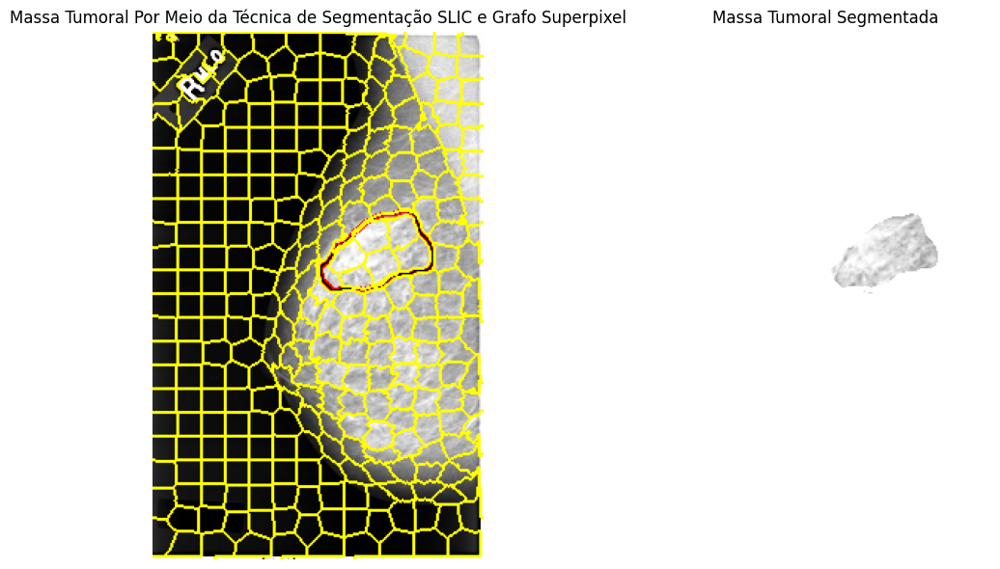

In [ ]:
# Importação das bibliotecas necessárias
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
from skimage import io, color
from skimage.segmentation import slic, mark_boundaries
import networkx as nx
from tabulate import tabulate

def upload_image():
    """Solicita ao usuário o upload de uma imagem."""
    uploaded = files.upload()
    for filename in uploaded.keys():
        print(f"Arquivo {filename} carregado com sucesso!")
        return io.imread(filename)

def generate_superpixels(image, n_segments=200, compactness=10):
    """
    Gera superpixels usando a técnica SLIC.

    Parâmetros:
    - image: Imagem de entrada.
    - n_segments: Número de segmentos/superpixels desejados.
    - compactness: Parâmetro de compacidade do SLIC.

    Retorna:
    - segments: Superpixels gerados.
    """
    segments = slic(image, n_segments=n_segments, compactness=compactness, start_label=1)
    return segments

def build_rag_manual(image, segments):
    """
    Constrói o Region Adjacency Graph (RAG) manualmente.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Superpixels gerados.

    Retorna:
    - G: Grafo construído.
    """
    G = nx.Graph()

    # Adiciona os nós ao grafo
    for region in np.unique(segments):
        G.add_node(region)

    # Identifica pixels vizinhos para adicionar arestas
    rows, cols = segments.shape
    for r in range(rows - 1):
        for c in range(cols - 1):
            current = segments[r, c]
            right = segments[r, c + 1]
            down = segments[r + 1, c]
            if current != right:
                G.add_edge(current, right)
            if current != down:
                G.add_edge(current, down)
    return G

def select_and_visualize_superpixels(image, segments):
    """
    Permite ao usuário selecionar os valores dos centróides e exibir os superpixels correspondentes.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Superpixels gerados.
    """
    selected_regions = input("Digite os números dos centróides selecionados, separados por vírgula: ")
    selected_regions = [int(region.strip()) for region in selected_regions.split(",")]

    # Criar uma máscara para os superpixels selecionados
    mask = np.isin(segments, selected_regions)
    selected_image = np.zeros_like(image)
    selected_image[mask] = image[mask]

    # Criar a imagem segmentada sem a parte preta ao redor (parte escura será branca)
    tumor_only = image * mask[..., np.newaxis]  # Aplica a máscara
    tumor_only[tumor_only == 0] = 255  # Altera os valores de fundo para branco

    # Exibir as imagens
    fig, ax = plt.subplots(1, 2, figsize=(12, 6))

    # Imagem com superpixels selecionados
    ax[0].imshow(mark_boundaries(image, segments))
    ax[0].set_title("Massa Tumoral Por Meio da Técnica de Segmentação SLIC e Grafo Superpixel")
    ax[0].axis("off")

    # Imagem segmentada com fundo branco
    ax[1].imshow(tumor_only)
    ax[1].set_title("Massa Tumoral Segmentada")
    ax[1].axis("off")

    plt.tight_layout()
    plt.show()

# Pipeline Principal
def main():
    print("Faça upload da imagem:")
    image = upload_image()

    # Garantir que a imagem seja RGB
    if len(image.shape) == 2 or image.shape[2] == 1:
        image = color.gray2rgb(image)

    # Geração de Superpixels
    print("Gerando superpixels...")
    segments = generate_superpixels(image, n_segments=300, compactness=20)

    # Construção do RAG manualmente
    print("Construindo a RAG manualmente...")
    rag = build_rag_manual(image, segments)

    # Visualização e seleção de superpixels
    select_and_visualize_superpixels(image, segments)

if __name__ == '__main__':
    main()


#<font color=lightgreen>Tentando melhor, visualmente o resultado aparentemente foi o mesmo: este Algoritmo Segmenta a Imagem Pelo Método SLCI e exibe na tela a imagem segmentada, a Imagem com o grafo representando os centroides (arestas ou nós) e a imagem segmentada (superpixel) com a RAG região adjacente do grafo

Faça upload da imagem:


Saving 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia.png to 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia (11).png
Saving 3_C_0001_1.RIGHT_CC.LJPEG.1_highpass - Copia.png to 3_C_0001_1.RIGHT_CC.LJPEG.1_highpass - Copia.png
Saving 6_C_0002_1.LEFT_MLO.LJPEG.1_highpass - Copia.png to 6_C_0002_1.LEFT_MLO.LJPEG.1_highpass - Copia.png
Saving 8_C_0002_1.LEFT_CC.LJPEG.1_highpass.png to 8_C_0002_1.LEFT_CC.LJPEG.1_highpass.png
Saving 11_C_0003_1.RIGHT_CC.LJPEG.1_highpass.png to 11_C_0003_1.RIGHT_CC.LJPEG.1_highpass.png
Saving 15_C_0004_1.RIGHT_CC.LJPEG.1_highpass.png to 15_C_0004_1.RIGHT_CC.LJPEG.1_highpass.png
Saving 17_C_0006_1.RIGHT_MLO.LJPEG.1_highpass - Copia.png to 17_C_0006_1.RIGHT_MLO.LJPEG.1_highpass - Copia.png
Saving 19_C_0006_1.RIGHT_CC.LJPEG.1_highpass.png to 19_C_0006_1.RIGHT_CC.LJPEG.1_highpass.png
Saving 20_C_0006_1.LEFT_CC.LJPEG.1_highpass.png to 20_C_0006_1.LEFT_CC.LJPEG.1_highpass.png
Saving 25_C_0009_1.RIGHT_MLO.LJPEG.1_highpass.png to 25_C_0009_1.RIGHT_MLO.LJPEG.1_highpass.p

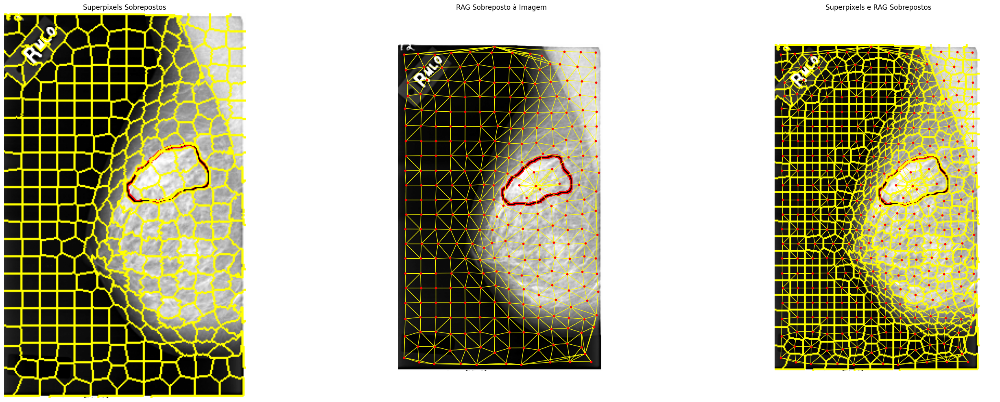

In [ ]:
# Importação das bibliotecas necessárias
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
from skimage import io, color
from skimage.segmentation import slic, mark_boundaries
import networkx as nx

def upload_image():
    """Solicita ao usuário o upload de uma imagem."""
    uploaded = files.upload()
    for filename in uploaded.keys():
        print(f"Arquivo {filename} carregado com sucesso!")
        return io.imread(filename)

def generate_superpixels(image, n_segments=200, compactness=10):
    """
    Gera superpixels usando a técnica SLIC.

    Parâmetros:
    - image: Imagem de entrada.
    - n_segments: Número de segmentos/superpixels desejados.
    - compactness: Parâmetro de compacidade do SLIC.

    Retorna:
    - segments: Superpixels gerados.
    """
    segments = slic(image, n_segments=n_segments, compactness=compactness, start_label=1)
    return segments

def build_rag_manual(image, segments):
    """
    Constrói o Region Adjacency Graph (RAG) manualmente.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Superpixels gerados.

    Retorna:
    - G: Grafo construído.
    """
    G = nx.Graph()

    # Adiciona os nós ao grafo
    for region in np.unique(segments):
        G.add_node(region)

    # Identifica pixels vizinhos para adicionar arestas
    rows, cols = segments.shape
    for r in range(rows - 1):
        for c in range(cols - 1):
            current = segments[r, c]
            right = segments[r, c + 1]
            down = segments[r + 1, c]
            if current != right:
                G.add_edge(current, right)
            if current != down:
                G.add_edge(current, down)
    return G

def visualize_all(image, segments, rag):
    """
    Exibe três imagens lado a lado:
    1. Superpixels sobrepostos à imagem original.
    2. RAG sobreposto à imagem original.
    3. Superpixels e RAG sobrepostos à imagem original.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Superpixels gerados.
    - rag: Grafo de Adjacência da Região (RAG).
    """
    fig, ax = plt.subplots(1, 3, figsize=(30, 10))

    # Superpixels sobrepostos
    ax[0].imshow(mark_boundaries(image, segments))
    ax[0].set_title("Superpixels Sobrepostos")
    ax[0].axis("off")

    # RAG sobreposto à imagem
    ax[1].imshow(image)
    pos = {}
    for region in np.unique(segments):
        mask = segments == region
        y, x = np.mean(np.argwhere(mask), axis=0)
        pos[region] = (x, y)

    nx.draw(rag, pos, ax=ax[1], node_size=10, edge_color="yellow", node_color="red", with_labels=False)
    ax[1].set_title("RAG Sobreposto à Imagem")
    ax[1].axis("off")

    # Superpixels e RAG juntos
    ax[2].imshow(mark_boundaries(image, segments))
    nx.draw(rag, pos, ax=ax[2], node_size=10, edge_color="yellow", node_color="red", with_labels=False)
    ax[2].set_title("Superpixels e RAG Sobrepostos")
    ax[2].axis("off")

    plt.tight_layout()
    plt.show()

# Pipeline Principal
def main():
    print("Faça upload da imagem:")
    image = upload_image()

    # Garantir que a imagem seja RGB
    if len(image.shape) == 2 or image.shape[2] == 1:
        image = color.gray2rgb(image)

    # Geração de Superpixels
    print("Gerando superpixels...")
    segments = generate_superpixels(image, n_segments=300, compactness=20)

    # Construção do RAG manualmente
    print("Construindo a RAG manualmente...")
    rag = build_rag_manual(image, segments)

    # Visualização
    print("Visualizando a RAG e os Superpixels...")
    visualize_all(image, segments, rag)

if __name__ == '__main__':
    main()

#<font color=lightgreen>Implementando o mesmo algoritmo com método SLIC para várias imagens do dataset usado neste estudo.

Faça upload das imagens:


Saving 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia.png to 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia (12).png
Saving 3_C_0001_1.RIGHT_CC.LJPEG.1_highpass.png to 3_C_0001_1.RIGHT_CC.LJPEG.1_highpass.png
Saving 6_C_0002_1.LEFT_MLO.LJPEG.1_highpass - Copia.png to 6_C_0002_1.LEFT_MLO.LJPEG.1_highpass - Copia (1).png
Saving 8_C_0002_1.LEFT_CC.LJPEG.1_highpass - Copia.png to 8_C_0002_1.LEFT_CC.LJPEG.1_highpass - Copia.png
Saving 9_C_0003_1.RIGHT_MLO.LJPEG.1_highpass - Copia.png to 9_C_0003_1.RIGHT_MLO.LJPEG.1_highpass - Copia.png
Saving 11_C_0003_1.RIGHT_CC.LJPEG.1_highpass.png to 11_C_0003_1.RIGHT_CC.LJPEG.1_highpass (1).png
Saving 15_C_0004_1.RIGHT_CC.LJPEG.1_highpass - Copia.png to 15_C_0004_1.RIGHT_CC.LJPEG.1_highpass - Copia.png
Saving 17_C_0006_1.RIGHT_MLO.LJPEG.1_highpass - Copia.png to 17_C_0006_1.RIGHT_MLO.LJPEG.1_highpass - Copia (1).png
Saving 19_C_0006_1.RIGHT_CC.LJPEG.1_highpass.png to 19_C_0006_1.RIGHT_CC.LJPEG.1_highpass (1).png
Saving 25_C_0009_1.RIGHT_MLO.LJPEG.1_highpa

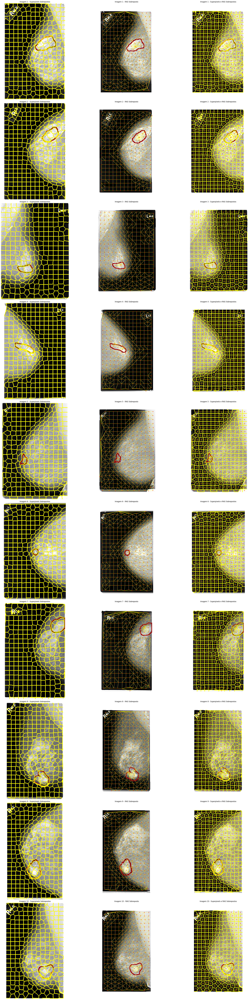

In [ ]:
# Importação das bibliotecas necessárias
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
from skimage import io, color
from skimage.segmentation import slic, mark_boundaries
import networkx as nx

def upload_images():
    """Solicita ao usuário o upload de várias imagens."""
    uploaded = files.upload()
    images = []
    for filename in uploaded.keys():
        print(f"Arquivo {filename} carregado com sucesso!")
        image = io.imread(filename)
        images.append(image)
    return images

def generate_superpixels(image, n_segments=200, compactness=10):
    """
    Gera superpixels usando a técnica SLIC.

    Parâmetros:
    - image: Imagem de entrada.
    - n_segments: Número de segmentos/superpixels desejados.
    - compactness: Parâmetro de compacidade do SLIC.

    Retorna:
    - segments: Superpixels gerados.
    """
    segments = slic(image, n_segments=n_segments, compactness=compactness, start_label=1)
    return segments

def build_rag_manual(image, segments):
    """
    Constrói o Region Adjacency Graph (RAG) manualmente.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Superpixels gerados.

    Retorna:
    - G: Grafo construído.
    """
    G = nx.Graph()

    # Adiciona os nós ao grafo
    for region in np.unique(segments):
        G.add_node(region)

    # Identifica pixels vizinhos para adicionar arestas
    rows, cols = segments.shape
    for r in range(rows - 1):
        for c in range(cols - 1):
            current = segments[r, c]
            right = segments[r, c + 1]
            down = segments[r + 1, c]
            if current != right:
                G.add_edge(current, right)
            if current != down:
                G.add_edge(current, down)
    return G

def visualize_all(images):
    """
    Exibe todas as imagens fornecidas pelo usuário com superpixels e RAG sobrepostos.

    Parâmetros:
    - images: Lista de imagens a serem exibidas.
    """
    fig, ax = plt.subplots(len(images), 3, figsize=(30, len(images) * 10))

    for i, image in enumerate(images):
        # Garantir que a imagem seja RGB
        if len(image.shape) == 2 or image.shape[2] == 1:
            image = color.gray2rgb(image)

        # Geração de Superpixels
        segments = generate_superpixels(image, n_segments=300, compactness=20)

        # Construção do RAG manualmente
        rag = build_rag_manual(image, segments)

        # Superpixels sobrepostos
        ax[i, 0].imshow(mark_boundaries(image, segments))
        ax[i, 0].set_title(f"Imagem {i+1} - Superpixels Sobrepostos")
        ax[i, 0].axis("off")

        # RAG sobreposto à imagem
        ax[i, 1].imshow(image)
        pos = {}
        for region in np.unique(segments):
            mask = segments == region
            y, x = np.mean(np.argwhere(mask), axis=0)
            pos[region] = (x, y)

        nx.draw(rag, pos, ax=ax[i, 1], node_size=10, edge_color="yellow", node_color="red", with_labels=False)
        ax[i, 1].set_title(f"Imagem {i+1} - RAG Sobreposto")
        ax[i, 1].axis("off")

        # Superpixels e RAG juntos
        ax[i, 2].imshow(mark_boundaries(image, segments))
        nx.draw(rag, pos, ax=ax[i, 2], node_size=10, edge_color="yellow", node_color="red", with_labels=False)
        ax[i, 2].set_title(f"Imagem {i+1} - Superpixels e RAG Sobrepostos")
        ax[i, 2].axis("off")

    plt.tight_layout()
    plt.show()

# Pipeline Principal
def main():
    print("Faça upload das imagens:")
    images = upload_images()

    # Visualização das imagens carregadas
    print("Visualizando as imagens com superpixels e RAG...")
    visualize_all(images)

if __name__ == '__main__':
    main()


#<font color=lightgreen> Implementando o algoritmo para o método de segmentação Felzenszwalb.

Faça upload da imagem:


Saving 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia.png to 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia.png
Arquivo 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia.png carregado com sucesso!
Gerando superpixels...
Construindo a RAG manualmente...
Visualizando a RAG e os Superpixels...


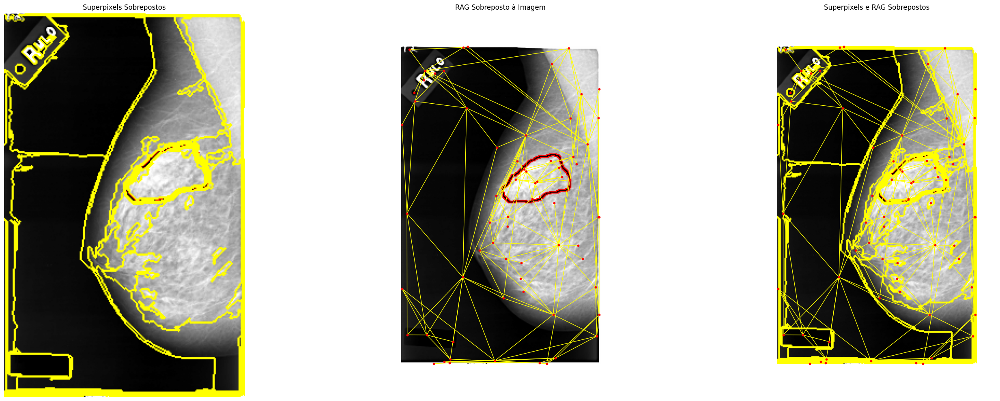

In [ ]:
# Importação das bibliotecas necessárias
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
from skimage import io, color
from skimage.segmentation import felzenszwalb, mark_boundaries
import networkx as nx

def upload_image():
    """Solicita ao usuário o upload de uma imagem."""
    uploaded = files.upload()
    for filename in uploaded.keys():
        print(f"Arquivo {filename} carregado com sucesso!")
        return io.imread(filename)

def generate_superpixels(image, scale=100, sigma=0.5, min_size=50):
    """
    Gera superpixels usando a técnica Felzenszwalb's Graph-Based Segmentation.

    Parâmetros:
    - image: Imagem de entrada.
    - scale: Parâmetro que regula a sensibilidade à variação de cor.
    - sigma: Fator de suavização antes da segmentação.
    - min_size: Tamanho mínimo permitido para os segmentos.

    Retorna:
    - segments: Superpixels gerados.
    """
    segments = felzenszwalb(image, scale=scale, sigma=sigma, min_size=min_size)
    return segments

def build_rag_manual(image, segments):
    """
    Constrói o Region Adjacency Graph (RAG) manualmente.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Superpixels gerados.

    Retorna:
    - G: Grafo construído.
    """
    G = nx.Graph()

    # Adiciona os nós ao grafo
    for region in np.unique(segments):
        G.add_node(region)

    # Identifica pixels vizinhos para adicionar arestas
    rows, cols = segments.shape
    for r in range(rows - 1):
        for c in range(cols - 1):
            current = segments[r, c]
            right = segments[r, c + 1]
            down = segments[r + 1, c]
            if current != right:
                G.add_edge(current, right)
            if current != down:
                G.add_edge(current, down)
    return G

def visualize_all(image, segments, rag):
    """
    Exibe três imagens lado a lado:
    1. Superpixels sobrepostos à imagem original.
    2. RAG sobreposto à imagem original.
    3. Superpixels e RAG sobrepostos à imagem original.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Superpixels gerados.
    - rag: Grafo de Adjacência da Região (RAG).
    """
    fig, ax = plt.subplots(1, 3, figsize=(30, 10))

    # Superpixels sobrepostos
    ax[0].imshow(mark_boundaries(image, segments))
    ax[0].set_title("Superpixels Sobrepostos")
    ax[0].axis("off")

    # RAG sobreposto à imagem
    ax[1].imshow(image)
    pos = {}
    for region in np.unique(segments):
        mask = segments == region
        y, x = np.mean(np.argwhere(mask), axis=0)
        pos[region] = (x, y)

    nx.draw(rag, pos, ax=ax[1], node_size=10, edge_color="yellow", node_color="red", with_labels=False)
    ax[1].set_title("RAG Sobreposto à Imagem")
    ax[1].axis("off")

    # Superpixels e RAG juntos
    ax[2].imshow(mark_boundaries(image, segments))
    nx.draw(rag, pos, ax=ax[2], node_size=10, edge_color="yellow", node_color="red", with_labels=False)
    ax[2].set_title("Superpixels e RAG Sobrepostos")
    ax[2].axis("off")

    plt.tight_layout()
    plt.show()

# Pipeline Principal
def main():
    print("Faça upload da imagem:")
    image = upload_image()

    # Garantir que a imagem seja RGB
    if len(image.shape) == 2 or image.shape[2] == 1:
        image = color.gray2rgb(image)

    # Geração de Superpixels
    print("Gerando superpixels...")
    segments = generate_superpixels(image, scale=200, sigma=0.8, min_size=50)

    # Construção do RAG manualmente
    print("Construindo a RAG manualmente...")
    rag = build_rag_manual(image, segments)

    # Visualização
    print("Visualizando a RAG e os Superpixels...")
    visualize_all(image, segments, rag)

if __name__ == '__main__':
    main()


In [ ]:
!pip install -U scikit-image


In [ ]:
!pip install PyMaxflow


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 798.4/798.4 kB 20.9 MB/s eta 0:00:00


In [ ]:
!pip install scikit-image networkx


#<font color=lightgreen>Implementando o algoritmo para o método de segmentação Watershed.

Faça upload da imagem:


Saving 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia.png to 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia (5).png
Arquivo 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia (5).png carregado com sucesso!
Gerando segmentos com Watershed...
Construindo a RAG manualmente...
Visualizando a RAG e os Segmentos...


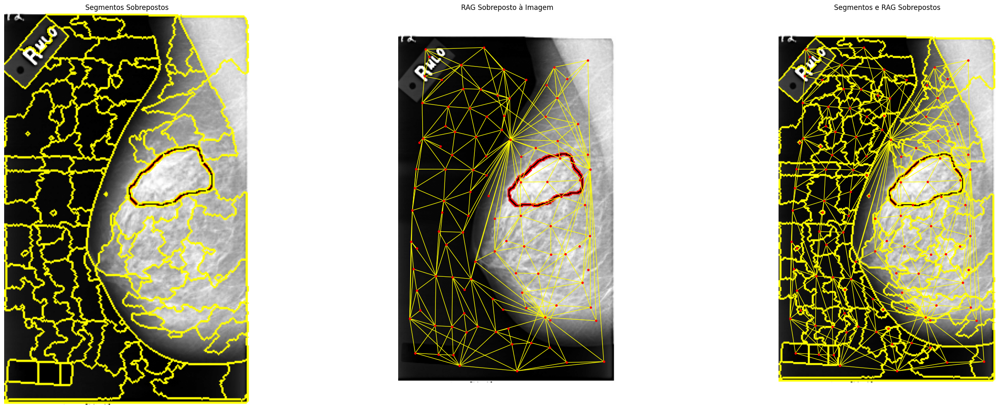

In [ ]:
# Importação das bibliotecas necessárias
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
from skimage import io, color
from skimage.segmentation import watershed, mark_boundaries
from skimage.feature import peak_local_max
from skimage.filters import sobel
from scipy import ndimage as ndi
import networkx as nx

def upload_image():
    """Solicita ao usuário o upload de uma imagem."""
    uploaded = files.upload()
    for filename in uploaded.keys():
        print(f"Arquivo {filename} carregado com sucesso!")
        return io.imread(filename)

def generate_segments_with_watershed(image):
    """
    Gera segmentos usando a técnica Watershed.

    Parâmetros:
    - image: Imagem de entrada.

    Retorna:
    - segments: Segmentação gerada.
    """
    # Converte a imagem para escala de cinza, se necessário
    if len(image.shape) == 3:
        image_gray = color.rgb2gray(image)
    else:
        image_gray = image

    # Aplica o gradiente (borda)
    gradient = sobel(image_gray)

    # Identifica máximos locais para Watershed
    local_maxi = peak_local_max(-gradient, footprint=np.ones((3, 3)), min_distance=20, labels=None)
    mask = np.zeros_like(image_gray, dtype=bool)
    mask[tuple(local_maxi.T)] = True  # Converte coordenadas para uma máscara booleana

    # Gera os marcadores para Watershed
    markers, _ = ndi.label(mask)

    # Aplica o Watershed
    segments = watershed(gradient, markers)
    return segments


def build_rag_manual(image, segments):
    """
    Constrói o Region Adjacency Graph (RAG) manualmente.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Segmentação gerada.

    Retorna:
    - G: Grafo construído.
    """
    G = nx.Graph()

    # Adiciona os nós ao grafo
    for region in np.unique(segments):
        G.add_node(region)

    # Identifica pixels vizinhos para adicionar arestas
    rows, cols = segments.shape
    for r in range(rows - 1):
        for c in range(cols - 1):
            current = segments[r, c]
            right = segments[r, c + 1]
            down = segments[r + 1, c]
            if current != right:
                G.add_edge(current, right)
            if current != down:
                G.add_edge(current, down)
    return G

def visualize_all(image, segments, rag):
    """
    Exibe três imagens lado a lado:
    1. Segmentos sobrepostos à imagem original.
    2. RAG sobreposto à imagem original.
    3. Segmentos e RAG sobrepostos à imagem original.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Segmentação gerada.
    - rag: Grafo de Adjacência da Região (RAG).
    """
    fig, ax = plt.subplots(1, 3, figsize=(30, 10))

    # Segmentos sobrepostos
    ax[0].imshow(mark_boundaries(image, segments))
    ax[0].set_title("Segmentos Sobrepostos")
    ax[0].axis("off")

    # RAG sobreposto à imagem
    ax[1].imshow(image)
    pos = {}
    for region in np.unique(segments):
        mask = segments == region
        y, x = np.mean(np.argwhere(mask), axis=0)
        pos[region] = (x, y)

    nx.draw(rag, pos, ax=ax[1], node_size=10, edge_color="yellow", node_color="red", with_labels=False)
    ax[1].set_title("RAG Sobreposto à Imagem")
    ax[1].axis("off")

    # Segmentos e RAG juntos
    ax[2].imshow(mark_boundaries(image, segments))
    nx.draw(rag, pos, ax=ax[2], node_size=10, edge_color="yellow", node_color="red", with_labels=False)
    ax[2].set_title("Segmentos e RAG Sobrepostos")
    ax[2].axis("off")

    plt.tight_layout()
    plt.show()

# Pipeline Principal
def main():
    print("Faça upload da imagem:")
    image = upload_image()

    # Garantir que a imagem seja RGB
    if len(image.shape) == 2 or image.shape[2] == 1:
        image = color.gray2rgb(image)

    # Geração de Segmentos
    print("Gerando segmentos com Watershed...")
    segments = generate_segments_with_watershed(image)

    # Construção do RAG manualmente
    print("Construindo a RAG manualmente...")
    rag = build_rag_manual(image, segments)

    # Visualização
    print("Visualizando a RAG e os Segmentos...")
    visualize_all(image, segments, rag)

if __name__ == '__main__':
    main()


#<font color=lightgreen>Implementando o algoritmo para o método de segmentação Connected Components.

Faça upload da imagem:


Saving 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia.png to 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia (6).png
Arquivo 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia (6).png carregado com sucesso!
Gerando segmentos com Componentes Conectados...
Construindo a RAG manualmente...
Visualizando a RAG e os Segmentos...


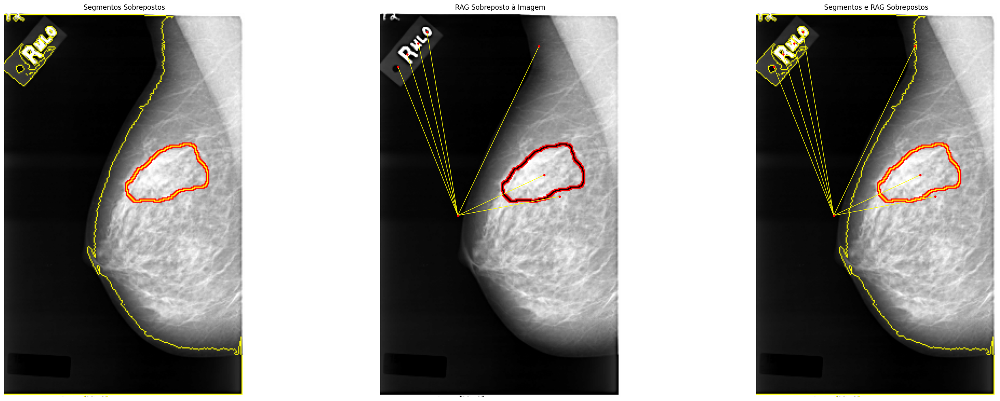

In [ ]:
# Importação das bibliotecas necessárias
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
from skimage import io, color, filters
from skimage.measure import label
from skimage.segmentation import mark_boundaries
import networkx as nx

def upload_image():
    """Solicita ao usuário o upload de uma imagem."""
    uploaded = files.upload()
    for filename in uploaded.keys():
        print(f"Arquivo {filename} carregado com sucesso!")
        return io.imread(filename)

def generate_segments_with_connected_components(image, threshold=0.5):
    """
    Gera segmentos usando o método de Componentes Conectados.

    Parâmetros:
    - image: Imagem de entrada.
    - threshold: Limiar para binarização (0 a 1).

    Retorna:
    - segments: Segmentos gerados.
    """
    # Converte a imagem para escala de cinza
    if len(image.shape) == 3:
        image_gray = color.rgb2gray(image)
    else:
        image_gray = image

    # Aplica o limiar à imagem
    binary = image_gray > filters.threshold_otsu(image_gray) * threshold

    # Gera os componentes conectados
    segments = label(binary)
    return segments

def build_rag_manual(image, segments):
    """
    Constrói o Region Adjacency Graph (RAG) manualmente.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Segmentos gerados.

    Retorna:
    - G: Grafo construído.
    """
    G = nx.Graph()

    # Adiciona os nós ao grafo
    for region in np.unique(segments):
        G.add_node(region)

    # Identifica pixels vizinhos para adicionar arestas
    rows, cols = segments.shape
    for r in range(rows - 1):
        for c in range(cols - 1):
            current = segments[r, c]
            right = segments[r, c + 1]
            down = segments[r + 1, c]
            if current != right:
                G.add_edge(current, right)
            if current != down:
                G.add_edge(current, down)
    return G

def visualize_all(image, segments, rag):
    """
    Exibe três imagens lado a lado:
    1. Segmentos sobrepostos à imagem original.
    2. RAG sobreposto à imagem original.
    3. Segmentos e RAG sobrepostos à imagem original.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Segmentos gerados.
    - rag: Grafo de Adjacência da Região (RAG).
    """
    fig, ax = plt.subplots(1, 3, figsize=(30, 10))

    # Segmentos sobrepostos
    ax[0].imshow(mark_boundaries(image, segments))
    ax[0].set_title("Segmentos Sobrepostos")
    ax[0].axis("off")

    # RAG sobreposto à imagem
    ax[1].imshow(image)
    pos = {}
    for region in np.unique(segments):
        mask = segments == region
        y, x = np.mean(np.argwhere(mask), axis=0)
        pos[region] = (x, y)

    nx.draw(rag, pos, ax=ax[1], node_size=10, edge_color="yellow", node_color="red", with_labels=False)
    ax[1].set_title("RAG Sobreposto à Imagem")
    ax[1].axis("off")

    # Segmentos e RAG juntos
    ax[2].imshow(mark_boundaries(image, segments))
    nx.draw(rag, pos, ax=ax[2], node_size=10, edge_color="yellow", node_color="red", with_labels=False)
    ax[2].set_title("Segmentos e RAG Sobrepostos")
    ax[2].axis("off")

    plt.tight_layout()
    plt.show()

# Pipeline Principal
def main():
    print("Faça upload da imagem:")
    image = upload_image()

    # Garantir que a imagem seja RGB
    if len(image.shape) == 2 or image.shape[2] == 1:
        image = color.gray2rgb(image)

    # Geração de Segmentos
    print("Gerando segmentos com Componentes Conectados...")
    segments = generate_segments_with_connected_components(image, threshold=0.5)

    # Construção do RAG manualmente
    print("Construindo a RAG manualmente...")
    rag = build_rag_manual(image, segments)

    # Visualização
    print("Visualizando a RAG e os Segmentos...")
    visualize_all(image, segments, rag)

if __name__ == '__main__':
    main()


#<font color=lightgreen>Instalando a biblioteca para análise da quantidade de mamória usada pelos algoritmos processarem as segmentações.

In [ ]:
!pip install memory_profiler


In [ ]:
import numpy as np
import time
from skimage import io, color
from skimage.segmentation import slic, felzenszwalb, watershed
from skimage.measure import label
from skimage import filters
from tabulate import tabulate
from google.colab import files
from memory_profiler import memory_usage

def upload_image():
    """Solicita ao usuário o upload de uma imagem."""
    uploaded = files.upload()
    for filename in uploaded.keys():
        print(f"Arquivo {filename} carregado com sucesso!")
        return io.imread(filename)

def measure_time_and_memory(func, *args, **kwargs):
    """
    Mede o tempo de execução e o uso de memória de uma função.
    """
    # Medir tempo de execução
    start_time = time.time()

    # Medir uso de memória durante a execução
    mem_usage = memory_usage((func, args, kwargs), interval=0.1)  # interval ajustado

    # Executar a função
    result = func(*args, **kwargs)

    # Medir tempo de execução
    end_time = time.time()
    execution_time = end_time - start_time

    # Encontrar o pico de memória usado (em MB)
    max_mem_usage = max(mem_usage) / 1024  # Convertendo para MB

    # Retornar o resultado, tempo de execução e memória usada (em MB)
    return result, execution_time, max_mem_usage

def generate_slic(image, n_segments=200, compactness=10):
    """
    Gera superpixels usando a técnica SLIC.
    """
    segments = slic(image, n_segments=n_segments, compactness=compactness, start_label=1)
    return segments

def generate_felzenszwalb(image):
    """
    Gera superpixels usando o algoritmo de Felzenszwalb.
    """
    segments = felzenszwalb(image, scale=100, sigma=0.5, min_size=50)
    return segments

def generate_watershed(image):
    """
    Gera superpixels usando o algoritmo Watershed.
    """
    # Gerar o gradiente da imagem
    gradient = filters.sobel(image)

    # Identificar os máximos locais
    markers = label(gradient < 0.1)

    # Gerar os segmentos usando o Watershed
    segments = watershed(gradient, markers)
    return segments

def generate_connected_components(image):
    """
    Gera componentes conectados usando o algoritmo de Connected Components.
    """
    # Convertendo a imagem para escala de cinza e binarizando
    gray_image = color.rgb2gray(image)
    binary_image = gray_image > 0.5  # Threshold para binarização

    # Encontrar os componentes conectados
    labeled_image = label(binary_image)
    return labeled_image

def main():
    print("Faça upload da imagem:")
    image = upload_image()

    # Garantir que a imagem seja RGB
    if len(image.shape) == 2 or image.shape[2] == 1:
        image = color.gray2rgb(image)

    # Medir tempo e memória para SLIC
    print("Gerando superpixels com SLIC...")
    _, slic_time, slic_memory = measure_time_and_memory(generate_slic, image, n_segments=300, compactness=20)

    # Medir tempo e memória para Felzenszwalb
    print("Gerando superpixels com Felzenszwalb...")
    _, felzenszwalb_time, felzenszwalb_memory = measure_time_and_memory(generate_felzenszwalb, image)

    # Medir tempo e memória para Watershed
    print("Gerando superpixels com Watershed...")
    _, watershed_time, watershed_memory = measure_time_and_memory(generate_watershed, image)

    # Medir tempo e memória para Connected Components
    print("Gerando superpixels com Connected Components...")
    _, connected_components_time, connected_components_memory = measure_time_and_memory(generate_connected_components, image)

    # Exibir a tabela de resultados
    table = [
        ["SLIC", slic_time, slic_memory],
        ["Felzenszwalb", felzenszwalb_time, felzenszwalb_memory],
        ["Watershed", watershed_time, watershed_memory],
        ["Connected Components", connected_components_time, connected_components_memory]
    ]
    headers = ["Método", "Tempo (segundos)", "Memória (MB)"]
    print(tabulate(table, headers=headers, tablefmt="pretty"))

if __name__ == '__main__':
    main()

Faça upload da imagem:


Saving 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia.png to 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia (1).png
Arquivo 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia (1).png carregado com sucesso!
Gerando superpixels com SLIC...
Gerando superpixels com Felzenszwalb...
Gerando superpixels com Watershed...
Gerando superpixels com Connected Components...
+----------------------+---------------------+--------------------+
|        Método        |  Tempo (segundos)   |    Memória (MB)    |
+----------------------+---------------------+--------------------+
|         SLIC         | 0.44673919677734375 | 0.6839561462402344 |
|     Felzenszwalb     | 0.48841381072998047 | 0.7021217346191406 |
|      Watershed       | 0.41265225410461426 | 0.7007484436035156 |
| Connected Components | 0.09787392616271973 | 0.6844062805175781 |
+----------------------+---------------------+--------------------+


In [ ]:
import numpy as np
import time
from skimage import io, color
from skimage.segmentation import slic, felzenszwalb, watershed
from skimage.measure import label
from skimage import filters
from tabulate import tabulate
from google.colab import files
from memory_profiler import memory_usage

def upload_image():
    """Solicita ao usuário o upload de uma imagem."""
    uploaded = files.upload()
    for filename in uploaded.keys():
        print(f"Arquivo {filename} carregado com sucesso!")
        return io.imread(filename)

def measure_time_and_memory(func, *args, **kwargs):
    """
    Mede o tempo de execução e o uso de memória de uma função.
    """
    # Medir tempo de execução
    start_time = time.time()

    # Medir uso de memória durante a execução
    mem_usage = memory_usage((func, args, kwargs), interval=0.1)  # interval ajustado

    # Executar a função
    result = func(*args, **kwargs)

    # Medir tempo de execução
    end_time = time.time()
    execution_time = end_time - start_time

    # Encontrar o pico de memória usado (em MB)
    max_mem_usage = max(mem_usage) / 1024  # Convertendo para MB

    # Retornar o resultado, tempo de execução e memória usada (em MB)
    return result, execution_time, max_mem_usage

def generate_slic(image, n_segments=200, compactness=10):
    """
    Gera superpixels usando a técnica SLIC.
    """
    segments = slic(image, n_segments=n_segments, compactness=compactness, start_label=1)
    return segments

def generate_felzenszwalb(image):
    """
    Gera superpixels usando o algoritmo de Felzenszwalb.
    """
    segments = felzenszwalb(image, scale=100, sigma=0.5, min_size=50)
    return segments

def generate_watershed(image):
    """
    Gera superpixels usando o algoritmo Watershed.
    """
    # Gerar o gradiente da imagem
    gradient = filters.sobel(image)

    # Identificar os máximos locais
    markers = label(gradient < 0.1)

    # Gerar os segmentos usando o Watershed
    segments = watershed(gradient, markers)
    return segments

def generate_connected_components(image):
    """
    Gera componentes conectados usando o algoritmo de Connected Components.
    """
    # Convertendo a imagem para escala de cinza e binarizando
    gray_image = color.rgb2gray(image)
    binary_image = gray_image > 0.5  # Threshold para binarização

    # Encontrar os componentes conectados
    labeled_image = label(binary_image)
    return labeled_image

def main():
    print("Faça upload da imagem:")
    image = upload_image()

    # Garantir que a imagem seja RGB
    if len(image.shape) == 2 or image.shape[2] == 1:
        image = color.gray2rgb(image)

    # Medir tempo e memória para SLIC
    print("Gerando superpixels com SLIC...")
    _, slic_time, slic_memory = measure_time_and_memory(generate_slic, image, n_segments=300, compactness=20)

    # Medir tempo e memória para Felzenszwalb
    print("Gerando superpixels com Felzenszwalb...")
    _, felzenszwalb_time, felzenszwalb_memory = measure_time_and_memory(generate_felzenszwalb, image)

    # Medir tempo e memória para Watershed
    print("Gerando superpixels com Watershed...")
    _, watershed_time, watershed_memory = measure_time_and_memory(generate_watershed, image)

    # Medir tempo e memória para Connected Components
    print("Gerando superpixels com Connected Components...")
    _, connected_components_time, connected_components_memory = measure_time_and_memory(generate_connected_components, image)

    # Exibir a tabela de resultados
    table = [
        ["SLIC", slic_time, slic_memory],
        ["Felzenszwalb", felzenszwalb_time, felzenszwalb_memory],
        ["Watershed", watershed_time, watershed_memory],
        ["Connected Components", connected_components_time, connected_components_memory]
    ]
    headers = ["Método", "Tempo (segundos)", "Memória (MB)"]
    print(tabulate(table, headers=headers, tablefmt="pretty"))

if __name__ == '__main__':
    main()

Faça upload da imagem:


Saving 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia.png to 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia (2).png
Saving 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass.png to 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass (1).png
Saving 2_C_0001_1.LEFT_MLO.LJPEG.1_highpass.png to 2_C_0001_1.LEFT_MLO.LJPEG.1_highpass.png
Saving 3_C_0001_1.RIGHT_CC.LJPEG.1_highpass - Copia.png to 3_C_0001_1.RIGHT_CC.LJPEG.1_highpass - Copia.png
Saving 3_C_0001_1.RIGHT_CC.LJPEG.1_highpass.png to 3_C_0001_1.RIGHT_CC.LJPEG.1_highpass.png
Saving 4_C_0001_1.LEFT_CC.LJPEG.1_highpass.png to 4_C_0001_1.LEFT_CC.LJPEG.1_highpass.png
Saving 5_C_0002_1.RIGHT_MLO.LJPEG.1_highpass.png to 5_C_0002_1.RIGHT_MLO.LJPEG.1_highpass.png
Saving 6_C_0002_1.LEFT_MLO.LJPEG.1_highpass - Copia.png to 6_C_0002_1.LEFT_MLO.LJPEG.1_highpass - Copia.png
Saving 6_C_0002_1.LEFT_MLO.LJPEG.1_highpass.png to 6_C_0002_1.LEFT_MLO.LJPEG.1_highpass.png
Saving 7_C_0002_1.RIGHT_CC.LJPEG.1_highpass.png to 7_C_0002_1.RIGHT_CC.LJPEG.1_highpass.png
Saving 8_C_0002_1.LE

#<font color=lightgreen>Verificando as Versões das Bibliotecas

In [ ]:
import sys
import numpy as np
import matplotlib as mpl
import skimage
import tabulate
import networkx as nx
import scipy
import time

print(f"NumPy version: {np.__version__}")
print(f"Matplotlib version: {mpl.__version__}")
print(f"Scikit-Image version: {skimage.__version__}")
print(f"Tabulate version: {tabulate.__version__}")
print(f"NetworkX version: {nx.__version__}")
print(f"SciPy version: {scipy.__version__}")
print(f"Python version: {sys.version}")

NumPy version: 1.26.4
Matplotlib version: 3.8.0
Scikit-Image version: 0.24.0
Tabulate version: 0.9.0
NetworkX version: 3.4.2
SciPy version: 1.13.1
Python version: 3.10.12 (main, Nov  6 2024, 20:22:13) [GCC 11.4.0]


In [ ]:
import sys

print(f"Python version: {sys.version}")

Python version: 3.10.12 (main, Nov  6 2024, 20:22:13) [GCC 11.4.0]


In [ ]:
import matplotlib as mpl

print(f"Matplotlib version: {mpl.__version__}")

Matplotlib version: 3.8.0


#<font color=lightgreen>Recursos Computacionais:

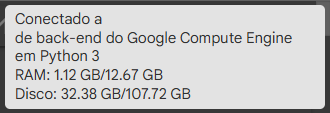

#<font color=red>**Observação**

##<font color=red>Conforme a Norma ABNT NBR ISO/IEC 42001:2024 de 18 de abril de 2024, que regulamenta a citação de fontes e conteúdos gerados por IA,

##<font color=red>Exemplo de citação:

##<font color=red>"Fonte: Gerada por: (nome da ferramenta de IA utilizada) e data de criação. Exemplo:

##<font color=red>Chat GPT, em 30 de abril de 2024."

#<font color=red>**Para Este Estudo:**

#<font color=red>**Alguns blocos de código neste estudo foi feito o uso de IA Chat GPT em novembro de 2024 com o objetivo de melhorar assintoticamente a complexidade de alguns blocos de código (def) tentando alcaçar a melhor possível otimização do algoritmo como um todo.**

#<font color=lightgreen>Referencia Bibliográfica:

[1]  ACHANTA, R., et al., SLIC Superpixels, EPFL Technical Report 149300, June 2010

[2] AVELAR, P. H. C., TAVARES, A. R., SILVEIRA, T. L. T., JUNG, C. R., LAMB L. C., Superpixel Image Classification with Graph Attention Networks, 2021, Institute of Informatics, Center of Computational Sciences Federal University of Rio Grande do Sul, Data Science Brigade Federal University of Rio Grande Porto Alegre, Brazil

[3] BOEMER, F., RATNER, E., LENDASSE, A., Parameter-Free Image Segmentation with SLIC, Neurocomputing (2017), doi: 10.1016/j.neucom.2017.05.096

[4] CARTER, S. M., et al., The ethical, legal and social implications of using artificial intelligence systems in breast cancer care, The Breast 49 (2020) 25e32, https://doi.org/10.1016/j.breast.2019.10.001

[5] CHU, J., MIN, H., LIU, L., LU, W., A novel computer aided breast mass detection scheme based on morphological enhancement and SLIC superpixel segmentation, Am. Assoc. Phys. Med., Med. Phys. 42 (7), July 2015, Med. Phys. 42 (7), July 2015

[6] COCCIA M. Deep Learning Technology For Improving Cancer Care In Society: New Directions In Cancer Imaging Driven By Artificial Intelligence, Technology in Society 2019, doi:https:// doi.org/10.1016/j.techsoc.2019.101198.

[7] ELHASSAN, B. T., ARABI, A. A., Ethical forethoughts on the use of artificial intelligence in medicine, International Journal of Ethics and Systems, 2024, DOI https://doi.org/10.1108/IJOES-08-2023-0190

[8] FERLAY J. et al., Cancer statistics for the year 2020: An overview, Union for International Cancer Control., Int. J. Cancer. 2021;1–12., DOI: 10.1002/ijc.33588

[9] GAMMOUDI, I., MAHJOUB, M. A., GUERDELLI, F., Unsupervised Image Segmentation based Graph Clustering Methods, Computación y Sistemas, Vol. 24, No. 3, 2020, pp. 969–987, doi: 10.13053/CyS-24-3-3059

[10] GAONA Y. J. et al. - DenseNet for Breast Tumor Classification in Mammographic 2022Images  -  BIOMESIP  2021: Bioengineering  and  Biomedical  Signal and Image Processing pp 166–176 - https://doi.org/10.1007/978-3-030-88163-4_16.

[11] HSU, C. Y., DING, J. J., Efficient Image Segmentation Algorithm Using SLIC Superpixels and Boundary-focused Region Merging, 2013 9th International Conference on Information, Communications & Signal Processing, IEEE Xplore: 2014, DOI: 10.1109/ICICS.2013.6782861

[12] INCA (Brasil), Estimativa 2023, Incidência do Câncer no Brasil, Instituto Nacional do Câncer, Rio de Janeiro: INCA, 2022

[13] ISTASY, P., The Impact of Artificial Intelligence on Health Equity in Oncology: Scoping Review, J Med Internet Res 2022, vol. 24, iss. 11, e39748, https://doi.org/ 10.2196/39748

[14] KAVEH, A., Graphs and structures, Computers & Structures, Volume 40, Issue 4, 1991, Pages 893-901, https://doi.org/10.1016/0045-7949(91)90319-H

[15] KUPPILI, V. N. S., CHEELU, D., BABU, M. R, KRIDHNA, P.V., Image Segmentation based on Connected Component Analysis, International Journal of Advances in Science and Technology, Vol. 2, No.3, 2011, ISSN 2229 5216

[16] LING, Y., Multi-view dual-channel graph convolutional networks with multi-task learning, Complex & Intelligent Systems (2024) 10:1953–1969 https://doi.org/10.1007/s40747-023-01250-w

[17] MIGOWSKI A. et al., Guidelines for early detection of breast cancer in Brazil. II – New national recommendations, main evidence, and controversies, Thematic Section: Breast Cancer in Brazil, Reports in Public Health 2018; 34(6):e00074817, doi: 10.1590/0102-311X00074817

[18] MIHAILA, A. F., et al., On Image Segmentation Using A Combination Of Felzenszwalb, Slic And Watershed Methods, Journal Of Information Systems & Operations Management, Vol. 14.1, May 2020

[19] PACILÈS, Serena et al. Improving breast cancer detection accuracy of mammography with the concurrent use of an artificial intelligence tool. Radiology: Artificial Intelligence, v. 2, n. 6, p. e190208, 2020.

[20] PAWAR, Shivaji D. et al. Multichannel DenseNet architecture for classification of mammographic breast density for breast cancer detection. Frontiers in Public Health, v. 10, p. 885212, 2022.

[21] RUBEIS, G.; DUBBALA K.; METZLER I. “Democratizing” artificial intelligence in medicine and healthcare: Mapping the uses of an elusive term, Front. Genet. 13:902542., 2022, doi: 10.3389/fgene.2022.902542

[22] SUNG H. et al., Global Cancer Statistics 2020: GLOBOCAN Estimates of Incidence and Mortality Worldwide for 36 Cancers in 185 Countries, CA CANCER J CLIN 2021;71:209–249, doi: 10.3322/caac.21660.

[23] SZWARCWALD C. L. et al. Health Inequalities in Rio de Janeiro, Brazil: Lower Healthy Life Expectancy in Socioeconomically Disadvantaged Areas, American Journal of Public Health, March 2011, Vol 101, No. 3.

[24] TAYLOR, Clayton R. et al. Artificial Intelligence Applications in Breast Imaging: Current Status and Future Directions. Diagnostics, v. 13, n. 12, p. 2041, 2023.

[26] TRANG, K., et al., Node-Based Graph Convolutional Network with SLIC Method for Breast Cancer Ultrasound Images Classification, IEEE TRANSACTIONS and JOURNALS, 2023, DOI 10.1109/ACCESS.2024.3488188

[27] YI, X.,  ZHANG, R., LI, H., CHEN, Y., An MFF-SLIC Hybrid Superpixel Segmentation Method with Multi-Source RS Data for Rock Surface Extraction. Appl. Sci. 2019, 9, 906. https://doi.org/10.3390/app9050906

#<font color=lightgreen>Documentação das Verções das Bibliotecas:

https://numpy.org/doc/1.26/

https://matplotlib.org/stable/users/prev_whats_new/whats_new_3.8.0.html

https://scikit-image.org/docs/stable/

https://pypi.org/project/tabulate/

https://networkx.org/documentation/stable/reference/index.html

https://docs.scipy.org/doc/scipy-1.13.1/

https://docs.python.org/release/3.10.12/

https://www.python.org/doc/versions/

https://www.python.org/downloads/release/python-31012/

#<font color=lightgreen>ANEXO - Método Graph Cuts (Este método ainda tem que ser mais estudado)

Faça upload da imagem:


Saving 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia.png to 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia (1).png
Arquivo 1_C_0001_1.RIGHT_MLO.LJPEG.1_highpass - Copia (1).png carregado com sucesso!
Gerando segmentos com Graph Cuts...
Construindo a RAG manualmente...
Visualizando a RAG e os Segmentos...


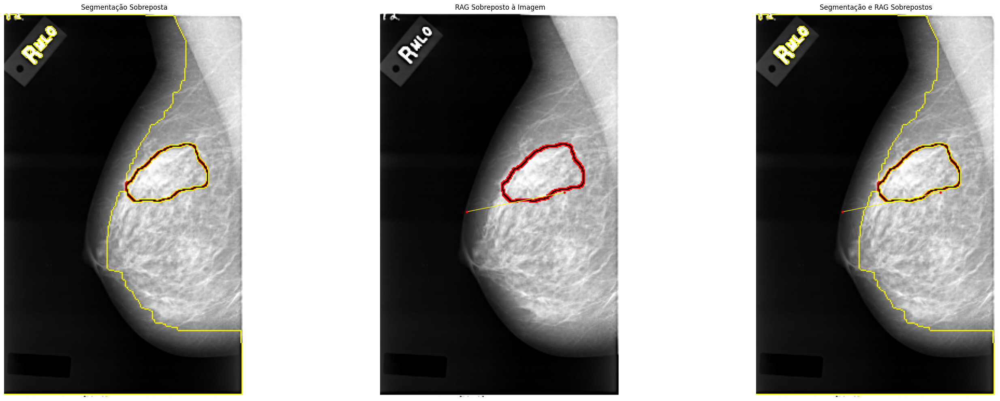

In [ ]:
# Importação das bibliotecas necessárias
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
from skimage import io, color
from skimage.segmentation import mark_boundaries
import maxflow
import networkx as nx

def upload_image():
    """Solicita ao usuário o upload de uma imagem."""
    uploaded = files.upload()
    for filename in uploaded.keys():
        print(f"Arquivo {filename} carregado com sucesso!")
        return io.imread(filename)

def generate_segments_with_graph_cuts(image, sigma=0.5):
    """
    Gera segmentos usando Graph Cuts com PyMaxflow.

    Parâmetros:
    - image: Imagem de entrada.
    - sigma: Variância para calcular a similaridade entre pixels.

    Retorna:
    - labels: Segmentação em forma de matriz.
    """
    # Converte a imagem para escala de cinza se necessário
    if len(image.shape) == 3:
        image_gray = color.rgb2gray(image)
    else:
        image_gray = image

    rows, cols = image_gray.shape
    num_nodes = rows * cols

    # Cria grafo
    g = maxflow.Graph[float]()
    node_ids = g.add_nodes(num_nodes)

    # Define parâmetros de similaridade entre pixels
    def edge_weight(pixel1, pixel2):
        return np.exp(-((pixel1 - pixel2) ** 2) / (2 * sigma ** 2))

    # Adiciona arestas entre pixels vizinhos
    for r in range(rows):
        for c in range(cols):
            current = r * cols + c
            if c < cols - 1:  # Pixel à direita
                right = r * cols + (c + 1)
                weight = edge_weight(image_gray[r, c], image_gray[r, c + 1])
                g.add_edge(current, right, weight, weight)
            if r < rows - 1:  # Pixel abaixo
                below = (r + 1) * cols + c
                weight = edge_weight(image_gray[r, c], image_gray[r + 1, c])
                g.add_edge(current, below, weight, weight)

    # Adiciona fontes e sorvedouros (neste exemplo, segmentação binária arbitrária)
    for r in range(rows):
        for c in range(cols):
            current = r * cols + c
            source_weight = edge_weight(image_gray[r, c], 0)  # Arbitrário
            sink_weight = edge_weight(image_gray[r, c], 1)  # Arbitrário
            g.add_tedge(current, source_weight, sink_weight)

    # Executa o corte no grafo
    g.maxflow()
    labels = np.array([g.get_segment(node) for node in range(num_nodes)], dtype=np.int32).reshape(rows, cols)

    return labels

def build_rag_manual(image, segments):
    """
    Constrói o Region Adjacency Graph (RAG) manualmente.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Segmentação gerada.

    Retorna:
    - G: Grafo construído.
    """
    G = nx.Graph()

    # Adiciona os nós ao grafo
    for region in np.unique(segments):
        G.add_node(region)

    # Identifica pixels vizinhos para adicionar arestas
    rows, cols = segments.shape
    for r in range(rows - 1):
        for c in range(cols - 1):
            current = segments[r, c]
            right = segments[r, c + 1]
            down = segments[r + 1, c]
            if current != right:
                G.add_edge(current, right)
            if current != down:
                G.add_edge(current, down)
    return G

def visualize_all(image, segments, rag):
    """
    Exibe três imagens lado a lado:
    1. Segmentação sobreposta à imagem original.
    2. RAG sobreposto à imagem original.
    3. Segmentação e RAG juntos.

    Parâmetros:
    - image: Imagem de entrada.
    - segments: Segmentação gerada.
    - rag: Grafo de Adjacência da Região (RAG).
    """
    fig, ax = plt.subplots(1, 3, figsize=(30, 10))

    # Segmentação sobreposta
    ax[0].imshow(mark_boundaries(image, segments))
    ax[0].set_title("Segmentação Sobreposta")
    ax[0].axis("off")

    # RAG sobreposto à imagem
    ax[1].imshow(image)
    pos = {}
    for region in np.unique(segments):
        mask = segments == region
        y, x = np.mean(np.argwhere(mask), axis=0)
        pos[region] = (x, y)

    nx.draw(rag, pos, ax=ax[1], node_size=10, edge_color="yellow", node_color="red", with_labels=False)
    ax[1].set_title("RAG Sobreposto à Imagem")
    ax[1].axis("off")

    # Segmentação e RAG juntos
    ax[2].imshow(mark_boundaries(image, segments))
    nx.draw(rag, pos, ax=ax[2], node_size=10, edge_color="yellow", node_color="red", with_labels=False)
    ax[2].set_title("Segmentação e RAG Sobrepostos")
    ax[2].axis("off")

    plt.tight_layout()
    plt.show()

# Pipeline Principal
def main():
    print("Faça upload da imagem:")
    image = upload_image()

    # Garantir que a imagem seja RGB
    if len(image.shape) == 2 or image.shape[2] == 1:
        image = color.gray2rgb(image)

    # Geração de Segmentação
    print("Gerando segmentos com Graph Cuts...")
    segments = generate_segments_with_graph_cuts(image, sigma=0.5)

    # Construção do RAG manualmente
    print("Construindo a RAG manualmente...")
    rag = build_rag_manual(image, segments)

    # Visualização
    print("Visualizando a RAG e os Segmentos...")
    visualize_all(image, segments, rag)

if __name__ == '__main__':
    main()
